In [1]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import timeit
import rasterio as rio
from rasterio.plot import plotting_extent
from rasterio.plot import show
from rasterio.enums import Resampling
from rasterio.shutil import delete
from tools_AA_IR import get_tif, reading_gps_file
from tools_AA import slice_raw, path_sonde
from tools_EL import readingtemp
from numba import jit
import geostatspy.geostats as geostats 
import matplotlib.patches as patches
import seaborn as sns
from matplotlib import cm
from sklearn.metrics import mean_squared_error

In [2]:
def dict_temp_sensor_function(date_1,date_2) :
    """
    fonction créant un dictionnaire regroupant les DATAFRAMES tronquées aux dates souhaitées 
    """
    
    ls_path = path_sonde()
    dict_temp_sensor = {}
    for i,ls_path_sonde in enumerate(ls_path):
        name = ls_path_sonde[0][ls_path_sonde[0].find("S"):(ls_path_sonde[0].find(".csv"))]
        Raw = readingtemp(ls_path_sonde[0])
        if name == "S3AIR" : #différence entre le nom du fichier et le reste du code.
            name = "S3-AIR"
        dict_temp_sensor[name] = slice_raw(Raw,date_1,date_2)
        #print("completed :",name)
    
    return dict_temp_sensor

In [3]:
def Import_variogram(REQUESTED_IR,TEMP,TYPE) :
    """
    Importation des données de variogrammes pré-calculés
    variogram : dictionnaire contenant différents données issus du calcul des variogrammes
    DataFrame : DataFrame contenant positions + valeurs 
    varc      : Variogrammes aux formats DataFrames
    """
    if TYPE == "Primary" :
        filename  = "./varr/Primary_variogram/Boucle/"+str(REQUESTED_IR)+"_"+str(TEMP)+".npy"
        variogram = np.load(filename,allow_pickle='TRUE').item()
        DataFrame = variogram["DataFrame"]
        varc      = variogram["Variogram"]
    
    elif TYPE == "Secondary" :
        filename  = "./varr/Secondary_variogram/Boucle/"+str(REQUESTED_IR)+"_convex.npy"
        #filename = "./varr/Secondary_variogram/Boucle/"+str(REQUESTED_IR)+"_ech10_convex.npy" 
        variogram = np.load(filename,allow_pickle='TRUE').item()
        DataFrame = variogram["DataFrame"]
        varc      = variogram["Variogram"]
        
    elif TYPE == "Cross" :
        filename  = "./varr/Cross_variogram/Boucle/"+str(REQUESTED_IR)+"_"+str(TEMP)+".npy"
        variogram = np.load(filename,allow_pickle='TRUE').item()
        DataFrame = variogram["DataFrame"]
        varc      = variogram["Variogram"]
        
    return variogram,DataFrame,varc
        
        

In [4]:
def replace_plaque_pseudotemp(Secondary, Primary,
                              original_std_y, original_mean_y,
                              radius = 0.5,
                              cluster_label = "vis",cluster_group = 6) :
    """
    Fonction qui permet de discriminer les pixels avec un clustering (ici sur la bande visible) et qui remplace 
    la valeur du signal IR d'un groupe de cluster (groupe 6) par la pseudo-temp 
    """
    SensorName = Primary["SensorName"].values
    Secondary = Secondary
    cluster_dict = {"hsv" : "val_cluster_hsv",
                   "vis" : "cluster_label_vis"}
    
    print(f"Remplacement des valeurs dans un rayon de {radius} m autour des plaques pour le cluster n°{cluster_group} ({cluster_label})")
    for Sensor in SensorName :
        Primary_Sensor = Primary.loc[Primary["SensorName"] == Sensor]
        x = Primary_Sensor["x"].values.astype(float)[0]
        y = Primary_Sensor["y"].values.astype(float)[0]
        
        # groupe de clustering qui discrimine plutot bien les plaques
        exp  = "X >= " + str(x-radius) + ' & ' + "X <= " + str(x+radius) + " & "
        exp += "Y >= " + str(y-radius) + ' & ' + "Y <= " + str(y+radius) + " & "
        exp += cluster_dict[cluster_label] + ' == ' +str(cluster_group) 
        
        #print("Valeurs à remplacer : \n",Secondary.query(exp))
        
        Secondary.loc[Secondary.eval(exp), "band 1"] = Primary_Sensor["Pseudo_temp"].values[0]
        Secondary.loc[Secondary.eval(exp), "Secondary"] = (Primary_Sensor["Pseudo_temp"].values[0] -original_mean_y )/ original_std_y
        
        #print("valeurs remplacées : \n", Secondary.loc[Secondary["band 1"] == Primary_Sensor["Pseudo_temp"].values[0]] )
        
        Secondary.loc[Secondary["band 1"] == Primary_Sensor["Pseudo_temp"].values[0]]
        
        #print("Completed : Sensor", Sensor, '\n \n')
    return Secondary

In [5]:
filename_Sensor_txt = "./traitement_PIREN/sondes_gps_UTM31N_phase1.txt"
Sensor_coord = reading_gps_file(filename_Sensor_txt)
Target_x = np.array(Sensor_coord["x"],dtype = float)
Target_y = np.array(Sensor_coord["y"],dtype = float)
Sensor_Name = np.array(Sensor_coord["SensorName"],dtype = str)
filename_Sensor_txt = "./traitement_PIREN/sondes_gps_UTM31N_phase1.txt"
Sensor_df = reading_gps_file(filename_Sensor_txt)
Sensor_df = Sensor_df.loc[Sensor_df["SensorName"] != "S3-AIR"]

# Plot Ortho-mosaïque

In [809]:
requested_path = './traitement_PIREN/vis_piren_phase_1_cropped_resampled_3.tif'
with rio.open(requested_path) as dataset :
    all_band_ext = plotting_extent(dataset)
    RGB = np.dstack((dataset.read(1),dataset.read(2),dataset.read(3))).astype(int)

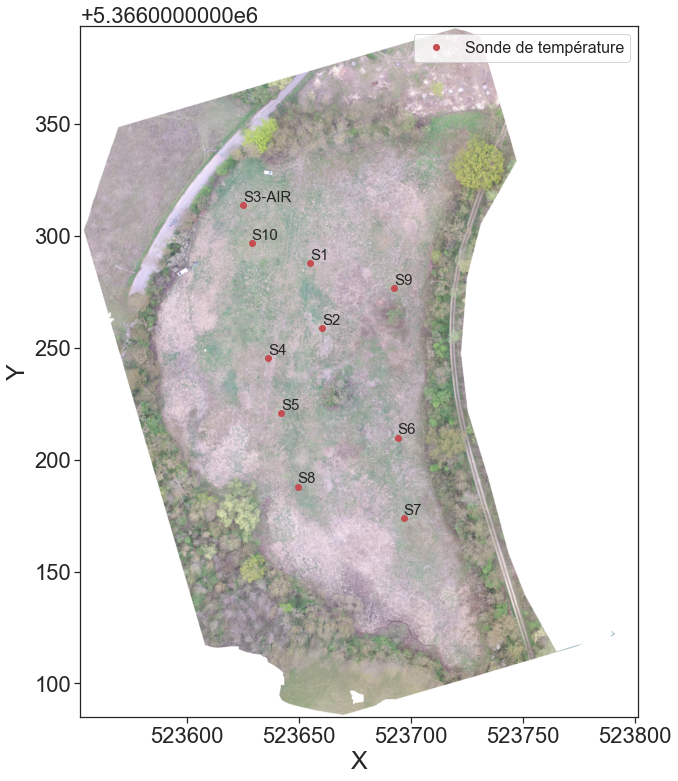

In [820]:
fig,ax = plt.subplots(1,1,figsize = (10,20))

ax.imshow(RGB,extent = all_band_ext)
ax.set_xlabel('X',fontsize=25)
ax.set_ylabel('Y',fontsize=25)
#ax.set_title("Orthomosaique de la zone d'étude",
#             size = 19, pad = 25)

Target_x = np.array(Sensor_df["x"],dtype = float)
Target_y = np.array(Sensor_df["y"],dtype = float)
Sensor_Name = np.array(Sensor_df["SensorName"],dtype = str)

plt.plot(Target_x,Target_y,"ro", label = "Sonde de température")
for k in range(len(Target_x)) :
    plt.text(Target_x[k],Target_y[k]+1.5,Sensor_Name[k], size = 15 )
    
ax.legend(fontsize = 16, loc = 'best')

fileout =  "C:/Users/Alexandre/Desktop/Cours/Stage/Rapport/contexte geo/orthomosaique.png"
fig.savefig(fileout,bbox_inches = 'tight' )


# Plot d'une IR

In [9]:
filetif = ['6H55', '7H29', '8H22', '9H28', '10H22', '11H27', '12H31', '13H26', '15H59', '17H27']
ls_path_tif,filetif = get_tif(filetif)


In [855]:
with rio.open(ls_path_tif[0]) as dataset :
    data = dataset.read(1)
    data_extent = plotting_extent(dataset)

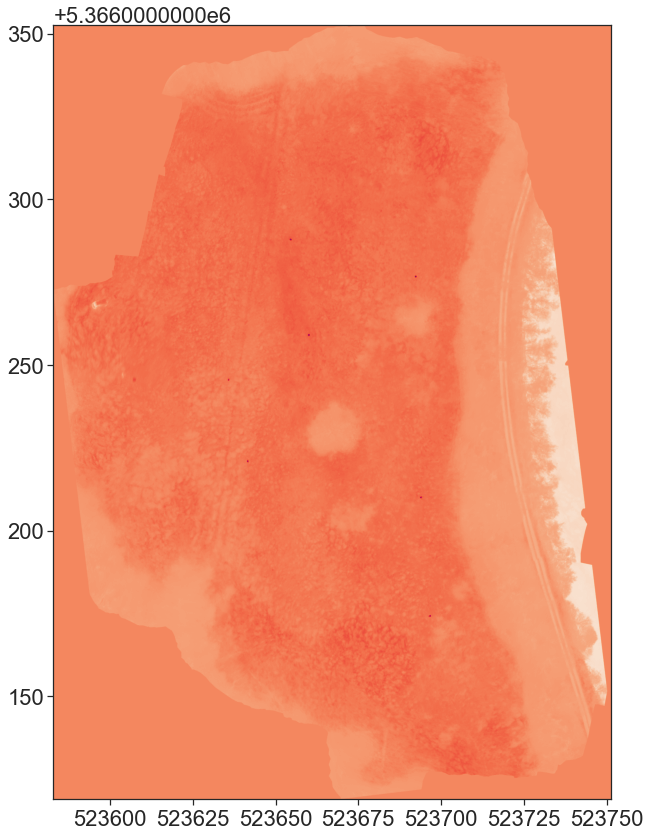

In [857]:
fig,ax = plt.subplots(1,1,figsize = (10,20))
ax.imshow(data,extent = data_extent)

## Version Scatter Plot

In [10]:
dict_IR_Df = np.load("dict_IR_Df.npy",allow_pickle='TRUE').item()
dict_IR_Df.keys() # Contient DataFrame et valeur d'échantillonage

dict_keys(['IR_6H55', 'IR_7H29', 'IR_8H22', 'IR_9H28', 'IR_10H22', 'IR_11H27', 'IR_12H31', 'IR_13H26', 'IR_15H59', 'IR_17H27'])

In [52]:
dict_IR_Df["IR_6H55"]

{'Secondary':                     X             Y  band 1  Secondary
 0       523582.977021  5.366124e+06     NaN        NaN
 1       523582.977021  5.366129e+06     NaN        NaN
 2       523582.977021  5.366135e+06     NaN        NaN
 3       523582.977021  5.366140e+06     NaN        NaN
 4       523582.977021  5.366145e+06     NaN        NaN
 ...               ...           ...     ...        ...
 140340  523751.281701  5.366327e+06     NaN        NaN
 140341  523751.281701  5.366333e+06     NaN        NaN
 140342  523751.281701  5.366338e+06     NaN        NaN
 140343  523751.281701  5.366343e+06     NaN        NaN
 140344  523751.281701  5.366349e+06     NaN        NaN
 
 [140345 rows x 4 columns],
 'echantillonage': 100}

In [54]:
requested_IR = ["IR_6H55"]

for IR in requested_IR :
    Secondary = dict_IR_Df[IR]["Secondary"]
    echantillonage = dict_IR_Df[IR]["echantillonage"]
    
X = Secondary["X"].astype(float).values
Y = Secondary["Y"].astype(float).values
Z = Secondary["band 1"].astype(float).values

In [78]:
# Rectangle noir pour plot
xx = float(Sensor_df.loc[Sensor_df["SensorName"] == "S10"]["x"][0])
yy = float(Sensor_df.loc[Sensor_df["SensorName"] == "S10"]["y"][0])
delta_xx = float(Sensor_df.loc[Sensor_df["SensorName"] == "S10"]["x"][0]) - float(Sensor_df.loc[Sensor_df["SensorName"] == "S7"]["x"][7])
delta_yy = float(Sensor_df.loc[Sensor_df["SensorName"] == "S10"]["y"][0]) - float(Sensor_df.loc[Sensor_df["SensorName"] == "S7"]["y"][7])

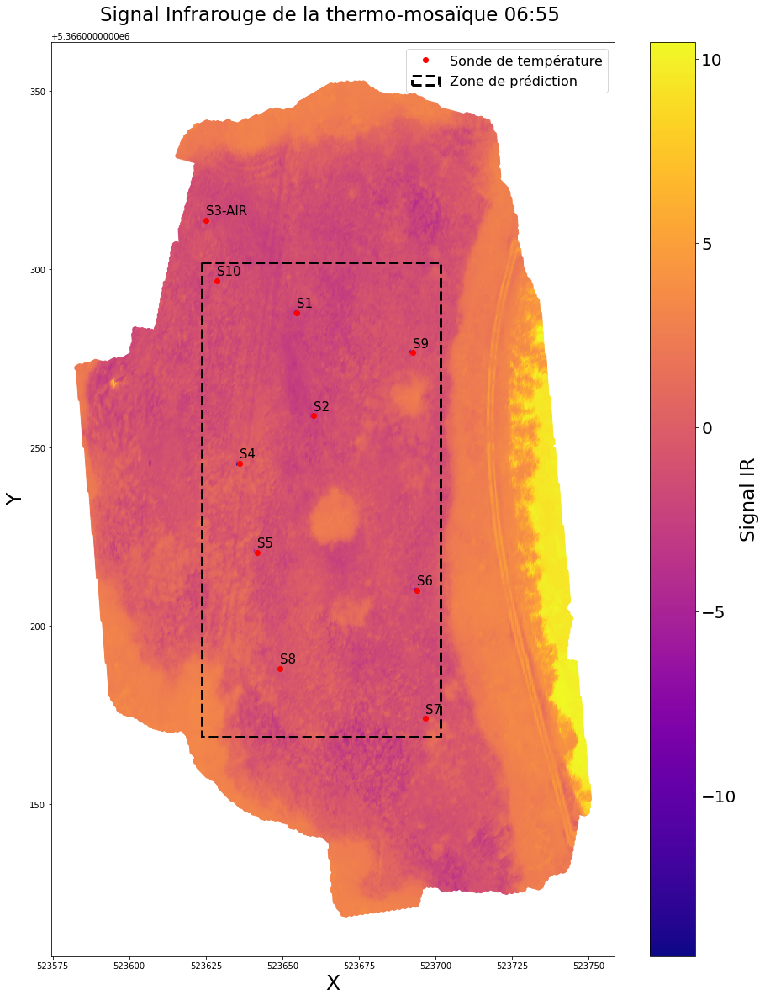

In [102]:

ech = 1
fig,ax=plt.subplots(1,1, figsize = (15,20))
img0 = ax.scatter(X,Y,c = Z, cmap = "plasma")
ax.set_xlabel('X',fontsize=25)
ax.set_ylabel('Y',fontsize=25)
cbar = fig.colorbar(img0, ax=ax)
ax.set_title("Signal Infrarouge de la thermo-mosaïque 06:55 ",
             size = 23, pad = 25)
cbar.set_label(label = "Signal IR",size = 23)
cbar.ax.tick_params(labelsize=20) 

# Coordonnées des sondes
Target_x = np.array(Sensor_df["x"],dtype = float)
Target_y = np.array(Sensor_df["y"],dtype = float)
Sensor_Name = np.array(Sensor_df["SensorName"],dtype = str)

plt.plot(Target_x,Target_y,"ro", label = "Sonde de température")
# Nom des sondes
for k in range(len(Target_x)) :
    plt.text(Target_x[k],Target_y[k]+1.5,Sensor_Name[k], size = 15 )

ax.legend(fontsize = 16)

rect = patches.Rectangle((xx-5, yy+5),-delta_xx+10, -delta_yy-10 , linewidth=3, edgecolor='black', 
                         linestyle = "--",facecolor='none', label = "Zone de prédiction")

# Add the patch to the Axes
ax.add_patch(rect)
ax.legend(fontsize = 16)
plt.show()

fileout =  "C:/Users/Alexandre/Desktop/Cours/Stage/Rapport/Prediction/zone_de_rediction.png"
fig.savefig(fileout,bbox_inches = 'tight' )

## Fenêtrage autour d'une sonde

In [716]:
Sensor = Sensor_df.loc[Sensor_df["SensorName"] == "S1"].values[0]
xx = float(Sensor[1])
yy = float(Sensor[2])

In [707]:
requested_IR = "IR_6H55"

In [714]:
condition = True
if condition :
    dict_IR_Df = np.load("Custom_dict_IR_convex_space_26_07_ech_50.npy",allow_pickle='TRUE').item()
    Secondary = dict_IR_Df[requested_IR]["Secondary"]

In [715]:
Secondary

,X,Y,band 1,cluster_label_vis,val_cluster_hsv,Secondary
0,523618.710,5.366164e+06,NaN,3.0,5.0,NaN
1,523618.710,5.366165e+06,NaN,2.0,5.0,NaN
2,523618.710,5.366166e+06,NaN,1.0,0.0,NaN
3,523618.710,5.366166e+06,NaN,3.0,0.0,NaN
4,523618.710,5.366167e+06,NaN,5.0,0.0,NaN
...,...,...,...,...,...,...
448568,523706.655,5.366304e+06,-0.519189,2.0,2.0,0.183163
448569,523706.655,5.366305e+06,-0.502596,2.0,1.0,0.198019
448570,523706.655,5.366305e+06,-0.293152,3.0,1.0,0.385537
448571,523706.655,5.366306e+06,-1.132541,2.0,2.0,-0.365979


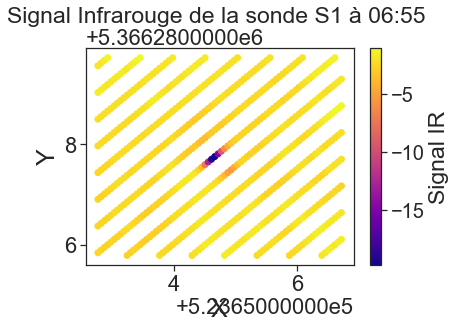

In [831]:
exp = "(X >= " + str(xx-2) + " & X <=" + str(xx+2) + ") & (Y >= " + str(yy-2) + " & Y <= " + str(yy+2) + ")"
close_view_sensor = Secondary.query(exp)

X = close_view_sensor["X"].astype(float).values
Y = close_view_sensor["Y"].astype(float).values
Z = close_view_sensor["band 1"].astype(float).values


ech = 1
fig,ax=plt.subplots(1,1)
img0 = ax.scatter(X,Y,c = Z, cmap = "plasma")
ax.set_xlabel('X',fontsize=25,x = 0.5)
ax.set_ylabel('Y',fontsize=25)
cbar = fig.colorbar(img0, ax=ax)
ax.set_title("Signal Infrarouge de la sonde S1 à 06:55 ",
             size = 23, pad = 25)
cbar.set_label(label = "Signal IR",size = 23)
cbar.ax.tick_params(labelsize=20) 



#ax.legend(fontsize = 16)
#fileout =  "C:/Users/Alexandre/Desktop/Cours/Stage/Rapport/Prediction/"+ str(requested_IR[0])+".png"
#fig.savefig(fileout,bbox_inches = 'tight' )


# Totalité des thermomosaïques

In [840]:
filetif = ['6H55', '7H29', '8H22', '9H28', '10H22', '11H27', '12H31', '13H26', '15H59', '17H27']
ls_path_tif,filetif = get_tif(filetif) # CHemin d'accès

In [844]:
ls_path_tif[0]

'./traitement_PIREN/001_6H55_ortho_UTM31N_IR.tif'

KeyboardInterrupt: 

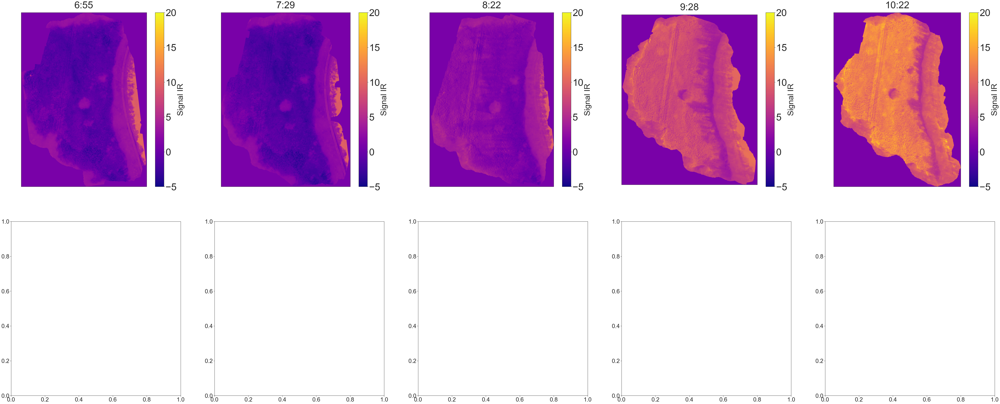

In [446]:
fig,ax = plt.subplots(2,5,figsize = (100,40))
jj = 0
ii = 0
for path_tif in ls_path_tif :
    with rio.open(path_tif) as dataset :
        data = dataset.read(1)
        data_extent = plotting_extent(dataset)
        
    img0 = ax[ii,jj].imshow(data,extent = data_extent, cmap = "plasma",vmin = -5 ,vmax = 20)
    b = path_tif.find("H")
    a = path_tif.find("_",b-5)
    IR_name =  path_tif[a+1 : b] + ":" + path_tif[b+1:b+3]
    #ax[ii,jj].set_xlabel('X',fontsize=35)
    #ax[ii,jj].set_ylabel('Y',fontsize=35)
    cbar = fig.colorbar(img0, ax=ax[ii,jj])
    ax[ii,jj].set_title(IR_name,
                 size = 55, pad = 25)
    cbar.set_label(label = "Signal IR",size = 45)
    cbar.ax.tick_params(labelsize=55) 
    ax[ii,jj].set_xticks([])
    ax[ii,jj].set_yticks([])
    #plt.setp(ax[ii,jj].get_xticklabels(), fontsize=30)
    #plt.setp(ax[ii,jj].get_yticklabels(), fontsize=30)
    jj += 1
    if jj == 5 :
        jj = 0
        ii += 1
        


### Estimation des variances des prédictions

In [1074]:
for IR in dict_IR_Df :
    filename = "./varr/Estimate/Estimate_"+IR+"_"+TEMP+".npy"
    dict_IR = np.load(filename,allow_pickle='TRUE').item() # chargement des interpolations
    ktypes_vals_dict = dict_IR["ktypes_vals_dict"]
    print(IR,"var SCK :", ktypes_vals_dict["SCK"]["Variance"])
    print(IR,"var ICCK :", ktypes_vals_dict["ICCK_MM2"]["Variance"])

IR_6H55 var SCK : 0.35406618504508913
IR_6H55 var ICCK : 0.20934157006656337
IR_7H29 var SCK : 0.3123242343758765
IR_7H29 var ICCK : 0.19342053530442435
IR_8H22 var SCK : 0.6072529473050587
IR_8H22 var ICCK : 0.28382704793599906
IR_9H28 var SCK : 59513.50444663894
IR_9H28 var ICCK : 1.1607036190237863
IR_10H22 var SCK : 280121667.30483943
IR_10H22 var ICCK : 2.451564941875181
IR_11H27 var SCK : 84565764.83137354
IR_11H27 var ICCK : 0.7771265613824165
IR_12H31 var SCK : 74456953.22417222
IR_12H31 var ICCK : 0.737850214043041
IR_13H26 var SCK : 1410673.9465184275
IR_13H26 var ICCK : 0.8280079375881794
IR_15H59 var SCK : 3.0536412976559073
IR_15H59 var ICCK : 0.3629229094496254
IR_17H27 var SCK : 0.7576838512835525
IR_17H27 var ICCK : 0.4903841887243102


# Figures d'interpolation

### Loading zone

In [6]:
## Package d'importation des noms 
dict_IR_Df = np.load("Custom_dict_IR_convex_space_26_07_ech_50.npy",allow_pickle='TRUE').item()
dict_IR_Df.keys()

dict_keys(['IR_6H55', 'IR_7H29', 'IR_8H22', 'IR_9H28', 'IR_10H22', 'IR_11H27', 'IR_12H31', 'IR_13H26', 'IR_15H59', 'IR_17H27'])

In [25]:
requested_IR = "IR_10H22"
TEMP = "T4"
a = requested_IR.find("_")
b = requested_IR.find("H")
IR_name =  requested_IR[a+1 : b] + ":" + requested_IR[b+1::]
## Primary
Primary_variogram,Primary,varc_1 = Import_variogram(requested_IR,TEMP,"Primary") 
# Original non Densifiée
Primary_original = Primary_variogram["DataFrame"]
# Primary Densifiée
Primary = Primary_variogram["DataFrame_dense"]
## Secondary
dict_IR_Df = np.load("Custom_dict_IR_convex_space_26_07_ech_50.npy",allow_pickle='TRUE').item()
Secondary = dict_IR_Df[requested_IR]["Secondary"]
# Re-enchantillonage
ech = 3
Secondary = Secondary.dropna(axis = 0)
Secondary = Secondary[::ech]
Secondary = Secondary.reset_index(drop=True)
# Stat
original_std_y = Secondary["band 1"].std()
original_var_y = Secondary["band 1"].var()
original_mean_y = Secondary["band 1"].mean()
## Cross
Cross_variogram,Cross,varc_3 = Import_variogram(requested_IR,TEMP,"Cross") 
Primary = Cross_variogram["DataFrame_dense"]
Primary_original = Cross_variogram["DataFrame"]
Secondary = replace_plaque_pseudotemp(Secondary, Primary_original, original_std_y, original_mean_y)

## Résultat de l'interpolation
filename = "./varr/Estimate/Estimate_"+requested_IR+"_"+TEMP+".npy"
dict_IR = np.load(filename,allow_pickle='TRUE').item()

# On déballe les dicts

dict_title = dict_IR["title"]
df_kriging = dict_IR["df_kriging"]
ktypes_vals_dict = dict_IR["ktypes_vals_dict"]
dict_primary = dict_IR["dict_primary"]
dict_cross = dict_IR["dict_cross"]
dict_secondary = dict_IR["dict_secondary"]
dict_scalling = dict_IR["dict_scalling"]
dict_primary_LMC = dict_IR["dict_primary_LMC"]
dict_cross_LMC = dict_IR["dict_cross_LMC"]
dict_secondary_LMC = dict_IR["dict_secondary_LMC"]

std_z = float("{:.0f}".format(Primary_original["Primary"].std()))
std_y = float("{:.0f}".format(Secondary["Secondary"].std()))
var_z = float("{:.0f}".format(Primary_original["Primary"].var()))
var_y = float("{:.0f}".format(Secondary["Secondary"].var()))
mean_z = float("{:.0f}".format(Primary_original["Primary"].mean()))
mean_y = float("{:.0f}".format(Secondary["Secondary"].mean()))

Remplacement des valeurs dans un rayon de 0.5 m autour des plaques pour le cluster n°6 (vis)


### vmap limit

In [11]:
vmin_e , vmax_e = -5 ,20

## Simple CK

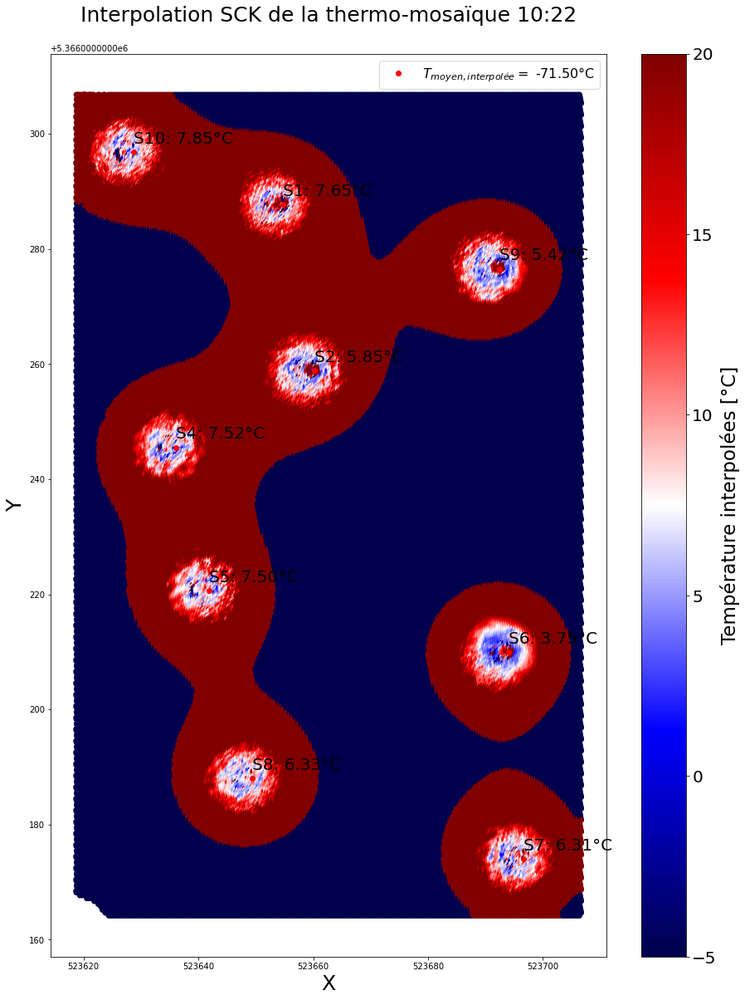

In [12]:
X = df_kriging["x"].values
Y = df_kriging["y"].values
Z = df_kriging["Estimate_SCK"].values

# On check les matrices crées, prend du temps à zaper si on s'en fout
ech = 1
fig,ax=plt.subplots(1,1, figsize = (15,20))
img0 = ax.scatter(X,Y,c = Z, cmap = "seismic",vmin = vmin_e, vmax = vmax_e)
ax.set_xlabel('X',fontsize=25)
ax.set_ylabel('Y',fontsize=25)
cbar = fig.colorbar(img0, ax=ax)
ax.set_title("Interpolation SCK de la thermo-mosaïque "+IR_name,
             size = 25, y = 1.03)
cbar.set_label(label = "Température interpolées [°C]",size = 23)
cbar.ax.tick_params(labelsize=20) 

LABEL = "$T_{moyen,interpolée}=$ " + "{:.2f}".format(df_kriging["Estimate_SCK"].mean()) + "°C" 

# Valeurs des sondes
Estimate_sensor_df = Sensor_df.loc[Sensor_df["SensorName"] != "S3-AIR"]
Target_x = np.array(Estimate_sensor_df["x"],dtype = float)
Target_y = np.array(Estimate_sensor_df["y"],dtype = float)
Sensor_Name = np.array(Estimate_sensor_df["SensorName"],dtype = str)
Sensor_value = np.array(Primary_original[TEMP])

plt.plot(Target_x,Target_y,"ro", label = LABEL)
for k in range(len(Target_x)) :
    plt.text(Target_x[k],Target_y[k]+1.5,Sensor_Name[k]+": "+"{:.2f}°C".format(Sensor_value[k]),
             size = 20 ,color = "black")

ax.legend(fontsize = 16)
plt.show()
cond = False
if cond :
    fileout = "C:/Users/Alexandre/Desktop/Cours/Stage/Modification/Interpolation/SCK_"+requested_IR+".png"
    fig.savefig(fileout,bbox_inches = 'tight')

## ICCK

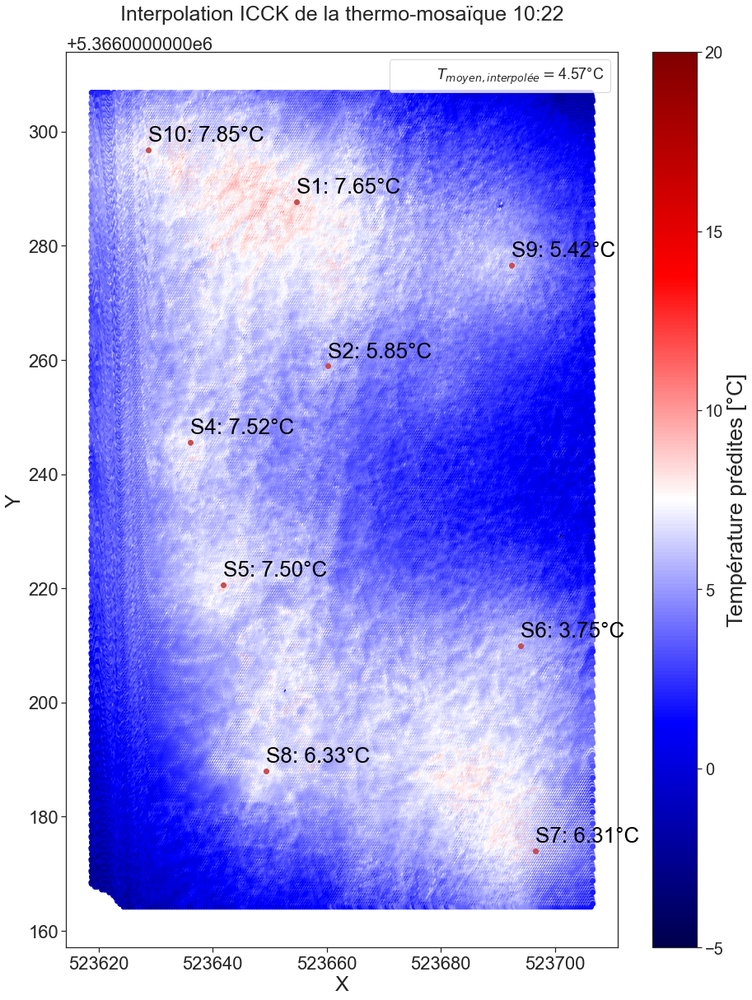

In [30]:
X = df_kriging["x"].values
Y = df_kriging["y"].values
Z = df_kriging["Estimate_ICCK_MM2"].values

# On check les matrices crées, prend du temps à zaper si on s'en fout
ech = 1
fig,ax=plt.subplots(1,1, figsize = (15,20))
img0 = ax.scatter(X,Y,c = Z, cmap = "seismic",
                  vmin = vmin_e, vmax = vmax_e)
ax.set_xlabel('X',fontsize=25)
ax.set_ylabel('Y',fontsize=25)
cbar = fig.colorbar(img0, ax=ax)
ax.set_title("Interpolation ICCK de la thermo-mosaïque "+IR_name,
             size = 25, y = 1.03)
cbar.set_label(label = "Température prédites [°C]",size = 27)
cbar.ax.tick_params(labelsize=20) 

# Valeurs des sondes
Estimate_sensor_df = Sensor_df.loc[Sensor_df["SensorName"] != "S3-AIR"]
Target_x = np.array(Estimate_sensor_df["x"],dtype = float)
Target_y = np.array(Estimate_sensor_df["y"],dtype = float)
Sensor_Name = np.array(Estimate_sensor_df["SensorName"],dtype = str)
LABEL = "$T_{moyen,interpolée} =$" + "{:.2f}".format(df_kriging["Estimate_ICCK_MM2"].mean()) + "°C" 
Sensor_value = np.array(Primary_original[TEMP])

plt.plot(Target_x,Target_y,"ro")
for k in range(len(Target_x)) :
    plt.text(Target_x[k],Target_y[k]+1.5,Sensor_Name[k]+": "+"{:.2f}°C".format(Sensor_value[k]),
             size = 26 ,color = "black")
plt.plot([],[], marker = ' ', color = "black" , linestyle= 'none',markersize = 10, label =LABEL)
ax.legend(fontsize = 18)
plt.show()
cond = False
if cond :
    fileout = "C:/Users/Alexandre/Desktop/Cours/Stage/Modification/Interpolation/ICCK_"+requested_IR+".png"
    fig.savefig(fileout,bbox_inches = 'tight')

# T moyennes prédites + sondes + S3-AIR

In [542]:
dict_IR_Df.keys() # noms des thermo-mosaïques

dict_keys(['IR_6H55', 'IR_7H29', 'IR_8H22', 'IR_9H28', 'IR_10H22', 'IR_11H27', 'IR_12H31', 'IR_13H26', 'IR_15H59', 'IR_17H27'])

In [12]:
list_mean_temp = []
list_IR = []
filename = "./varr/Estimate/S3_AIR_data.npy"
list_S3_AIR = np.load(filename,allow_pickle='TRUE')
list_mean_original = []
list_mean_estimate = []
# Noms des thermo-mosaïques pour label 
for requested_IR in dict_IR_Df :
    a = requested_IR.find("_")
    b = requested_IR.find("H")
    IR_name =  requested_IR[a+1 : b] + ":" + requested_IR[b+1::]
    TEMP = "T4"
    a = requested_IR.find("_")
    b = requested_IR.find("H")
    IR_name =  requested_IR[a+1 : b] + ":" + requested_IR[b+1::]
    
    ## Importation des Data Frame Primary et Secondary
    Primary_variogram,Primary,varc_1 = Import_variogram(requested_IR,TEMP,"Primary") 
    # Original non Densifiée
    Primary_original = Primary_variogram["DataFrame"]
    # Primary Densifiée
    Primary = Primary_variogram["DataFrame_dense"]
    filename = "./varr/Estimate/Estimate_"+requested_IR+"_"+TEMP+".npy"
    dict_IR = np.load(filename,allow_pickle='TRUE').item()

    # On déballe les dicts

    dict_title = dict_IR["title"]
    df_kriging = dict_IR["df_kriging"]
    ktypes_vals_dict = dict_IR["ktypes_vals_dict"]
    dict_primary = dict_IR["dict_primary"]
    dict_cross = dict_IR["dict_cross"]
    dict_secondary = dict_IR["dict_secondary"]
    dict_scalling = dict_IR["dict_scalling"]
    dict_primary_LMC = dict_IR["dict_primary_LMC"]
    dict_cross_LMC = dict_IR["dict_cross_LMC"]
    dict_secondary_LMC = dict_IR["dict_secondary_LMC"]
    
    list_mean_original.append(Primary_original["T4"].mean()) # moyenne des température au sol
    list_mean_estimate.append(df_kriging["Estimate_ICCK_MM2"].mean()) # moyenne des températures estimées
    list_IR.append(IR_name) # liste des noms des thermo-mosaïques

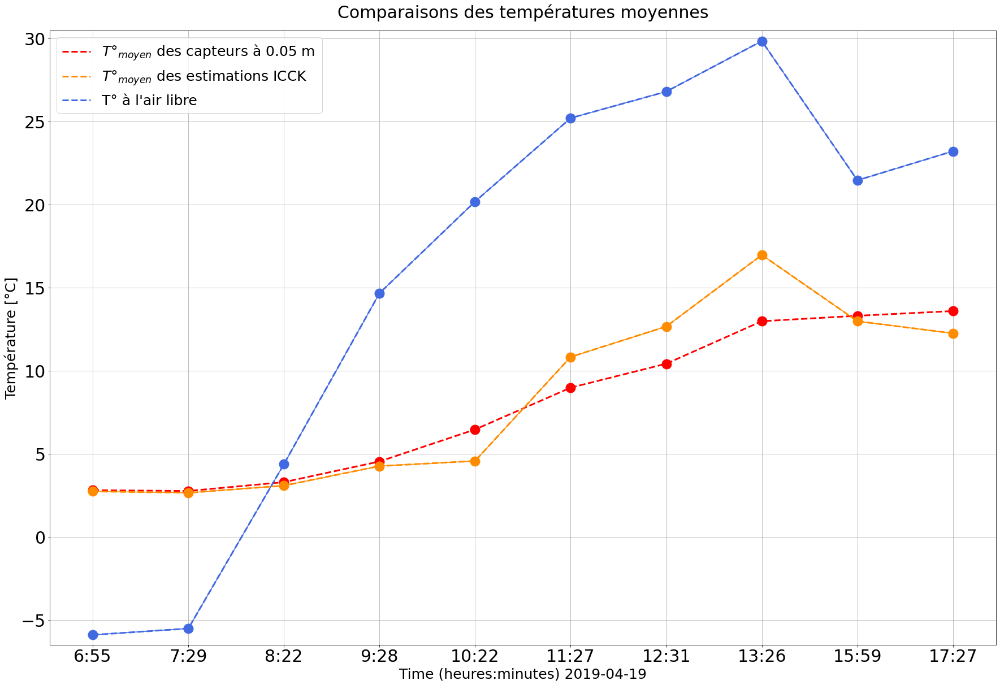

In [15]:
fig,ax = plt.subplots(1,figsize=(30,20))

# Capteur
ax.plot(list_IR,list_mean_original,color = "red", linewidth = 3,
        linestyle = "--",
        label = "$T°_{moyen}$ des capteurs à 0.05 m " )
ax.plot(list_IR,list_mean_original,'ro',
       markersize = 17)

# Predite par ICCK
ax.plot(list_IR,list_mean_estimate,color = "darkorange",linewidth = 3,
        linestyle = "--",
        label = "$T°_{moyen}$ des estimations ICCK " )
ax.plot(list_IR,list_mean_estimate,color = "darkorange",marker = 'o',
       markersize = 17)

# S3-AIR
ax.plot(list_IR,list_S3_AIR,color = "royalblue", linewidth = 3,
        linestyle = "--",
        label = "T° à l'air libre " )
ax.plot(list_IR,list_S3_AIR,color = "royalblue",marker = 'o',
       markersize = 17)


ax.legend(loc="best", prop={"size": 25})
ax.grid()
ax.set_ylim([-6.5,30.5])
ax.set_xlabel('Time (heures:minutes)' + ' 2019-04-19',fontsize=25)
ax.set_ylabel('Température [°C]',fontsize=25)
ax.tick_params(labelsize = 30)
ax.set_title("Comparaisons des températures moyennes", size = 30, y = 1.015)
fileout = "C:/Users/Alexandre/Desktop/Cours/Stage/Rapport/Prediction/comparaison_temp.png"
fig.savefig(fileout,bbox_inches = 'tight')

# Cluster + boxplot

Boxplot pour toutes les thermo-mosaïques séparement

## Clustering HSV

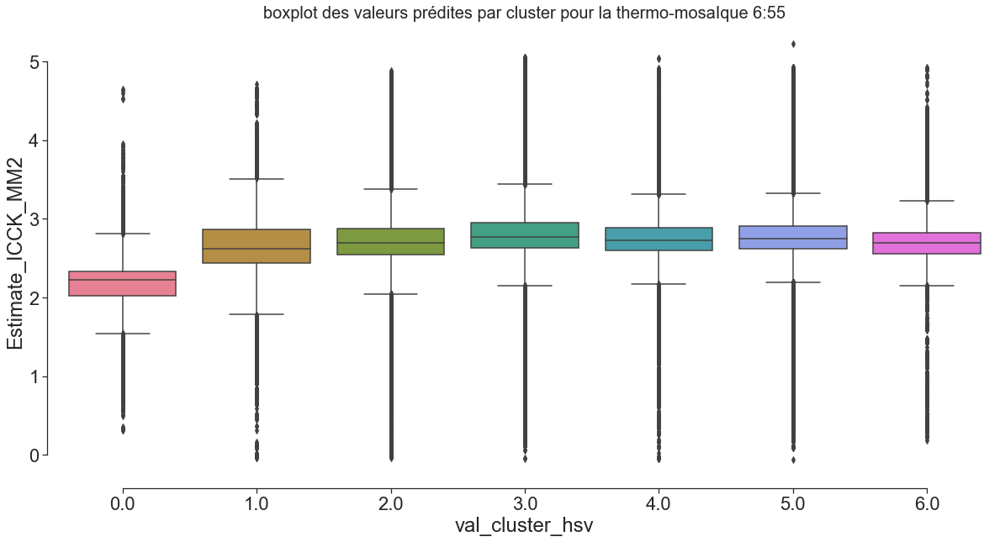

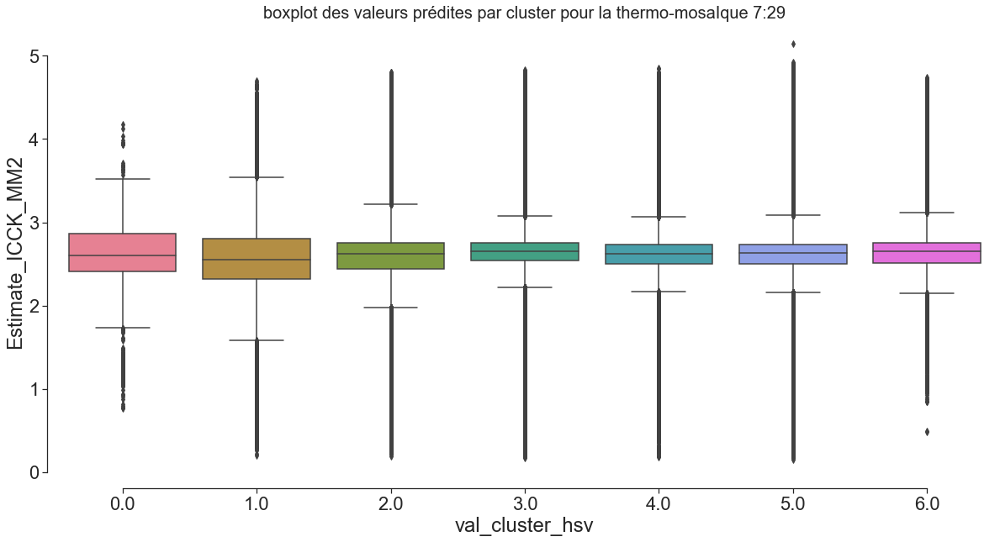

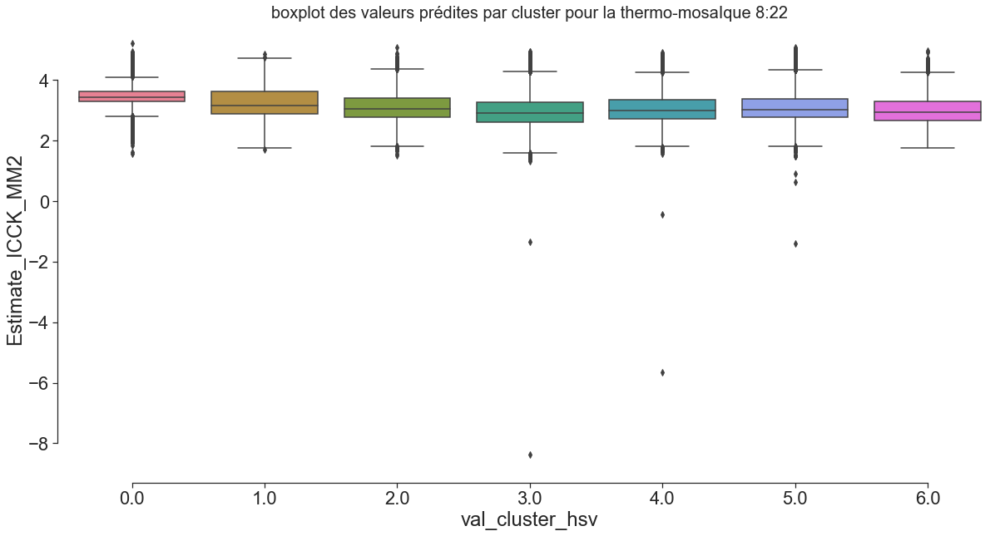

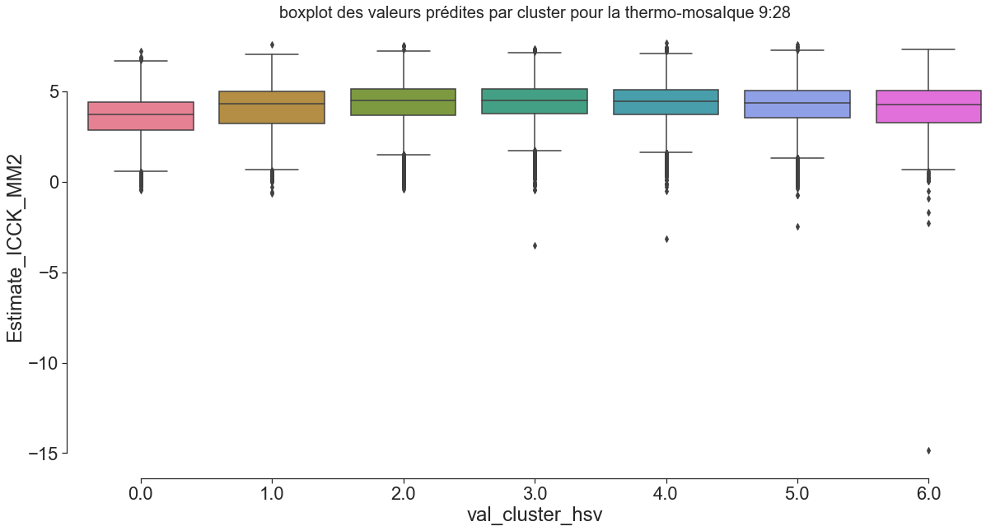

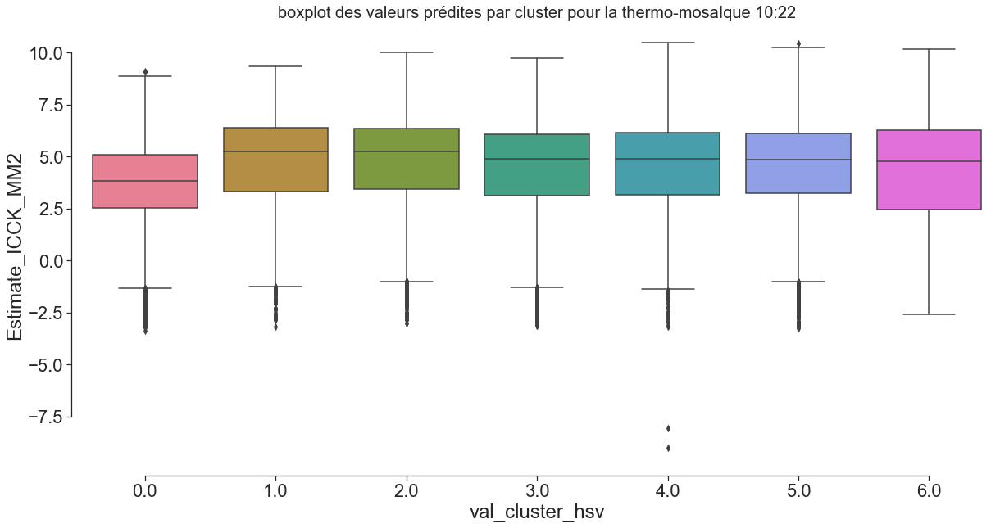

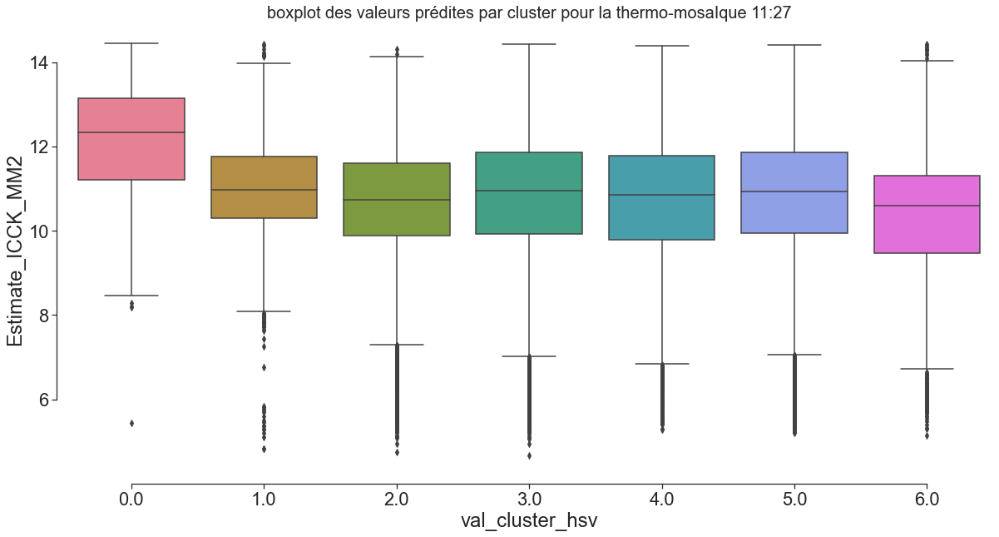

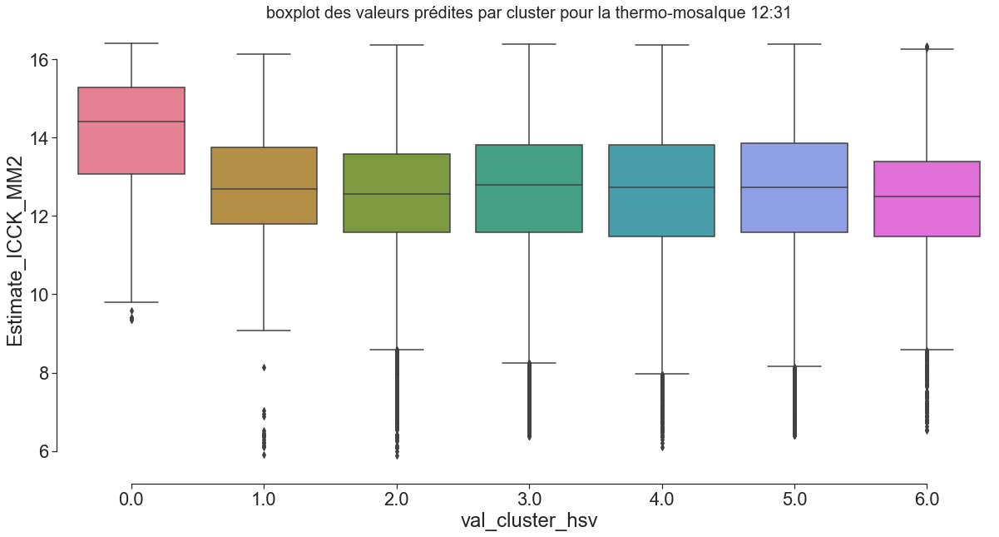

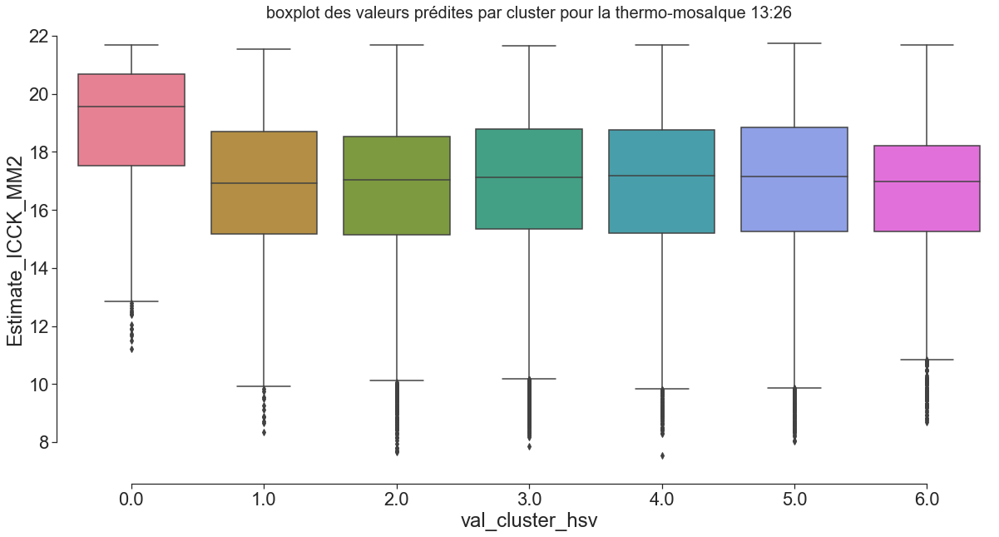

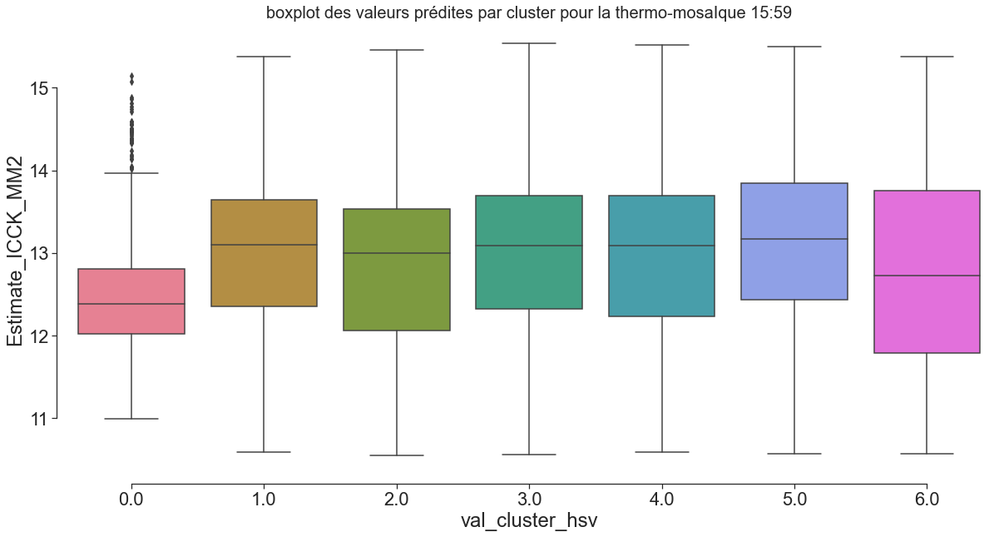

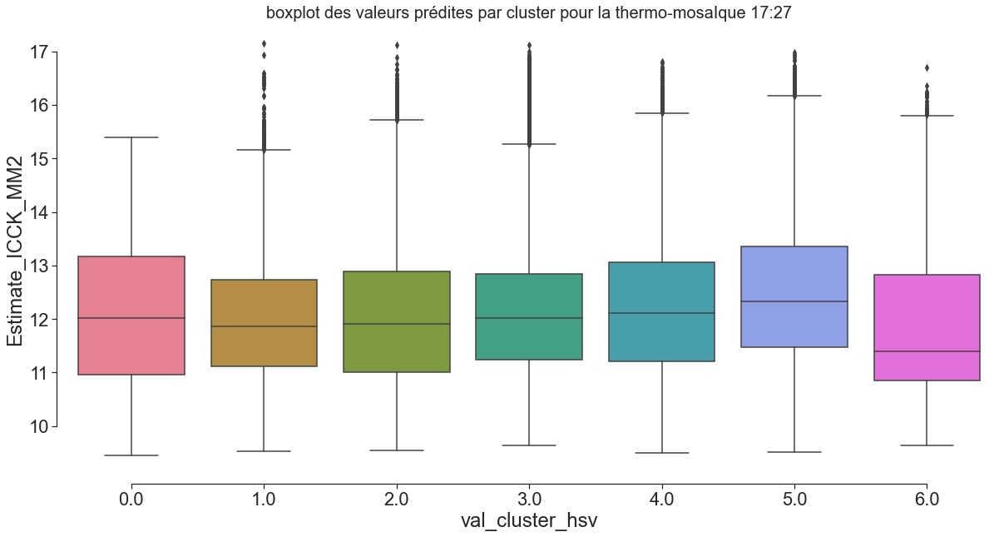

In [681]:
for requested_IR in dict_IR_Df :
    a = requested_IR.find("_")
    b = requested_IR.find("H")
    IR_name =  requested_IR[a+1 : b] + ":" + requested_IR[b+1::]
    TEMP = "T4"
    a = requested_IR.find("_")
    b = requested_IR.find("H")
    IR_name =  requested_IR[a+1 : b] + ":" + requested_IR[b+1::]
    filename = "./varr/Estimate/Estimate_"+requested_IR+"_"+TEMP+".npy"
    dict_IR = np.load(filename,allow_pickle='TRUE').item()
    df_kriging = dict_IR["df_kriging"]
    
    fig,ax=plt.subplots(1,1, figsize = (20,10))
    with sns.color_palette("husl",7) as cmap :
        data = df_kriging
        sns.boxplot(x='val_cluster_hsv',y="Estimate_ICCK_MM2",
                   data = data,palette = cmap,ax = ax )
        sns.set_theme(style="ticks",font_scale = 2)
        sns.despine(offset=10, trim=True)
    ax.set_title("boxplot des valeurs prédites par cluster pour la thermo-mosaIque "+IR_name, size = 20)

## Clustering Visible

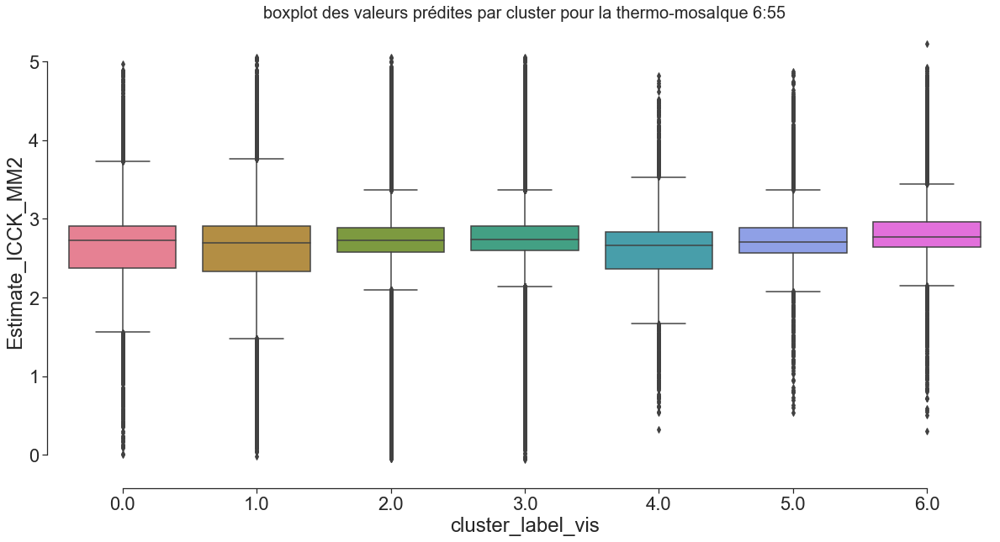

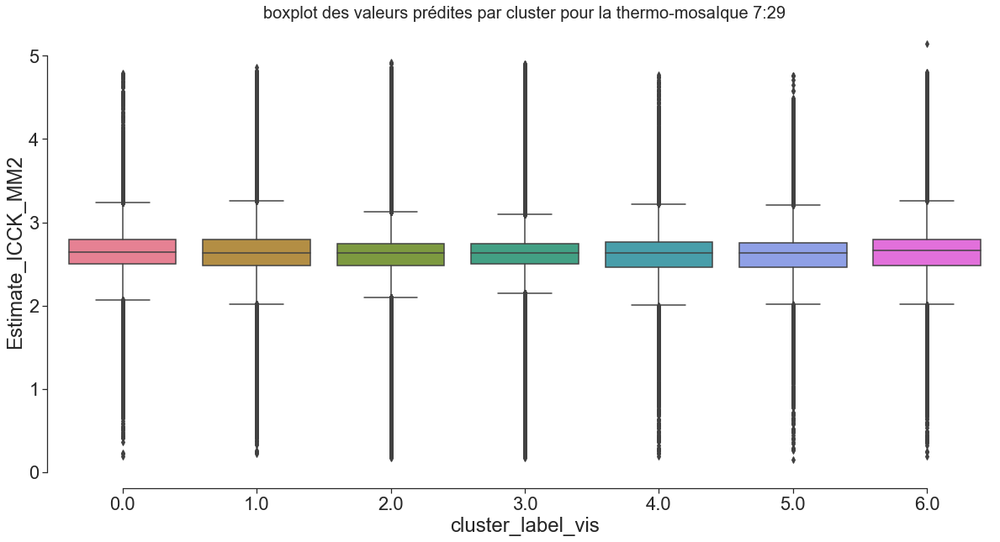

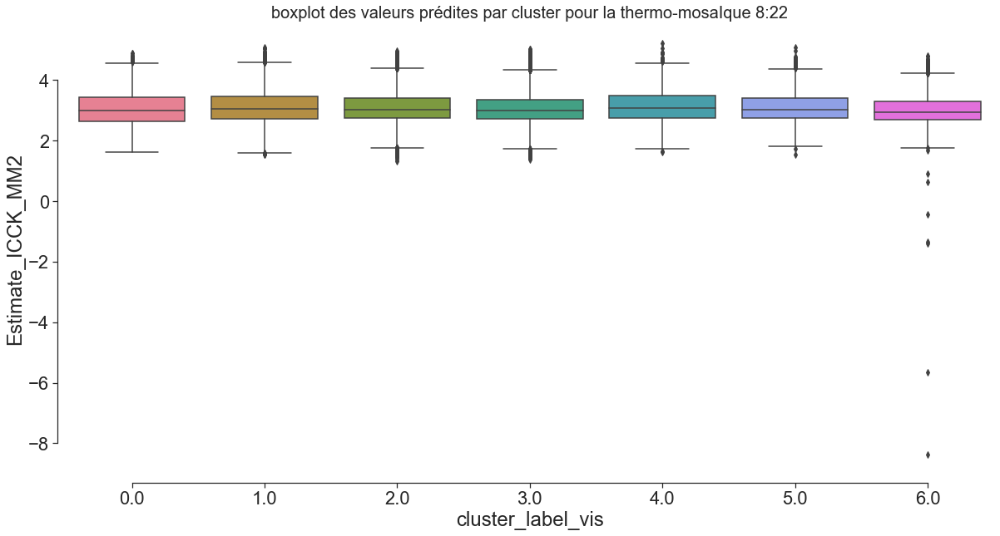

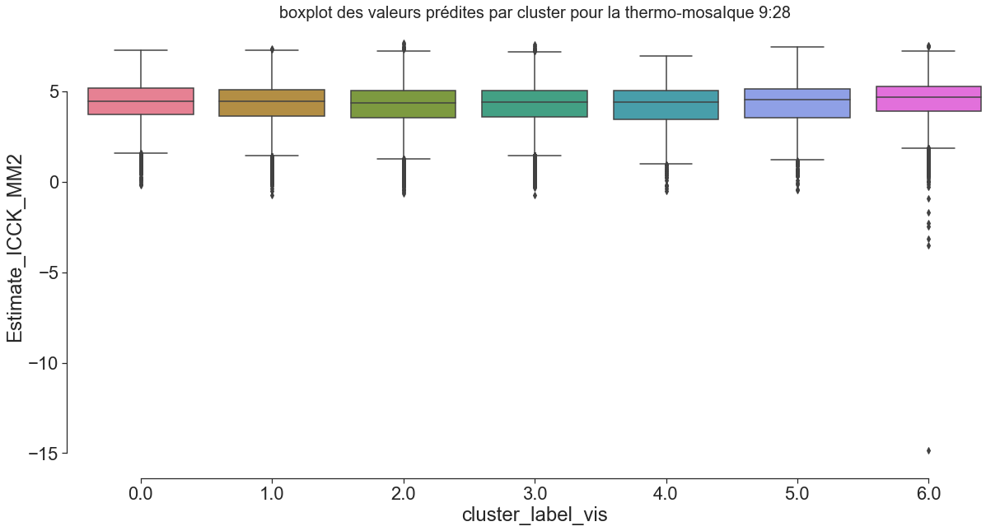

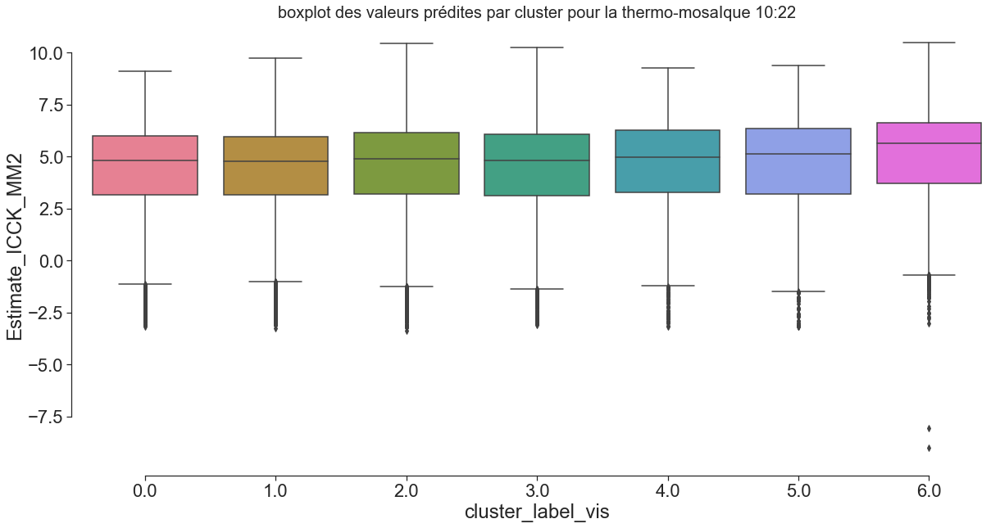

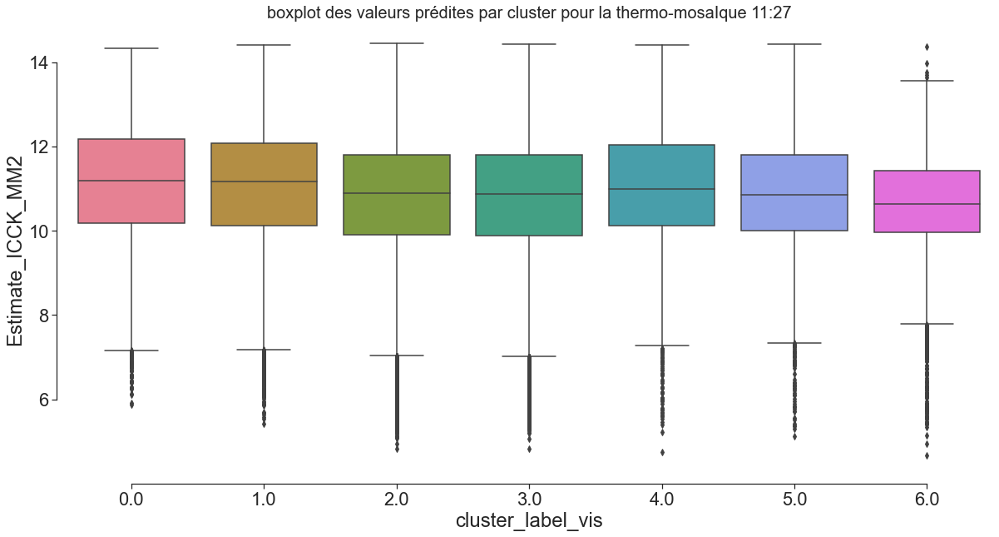

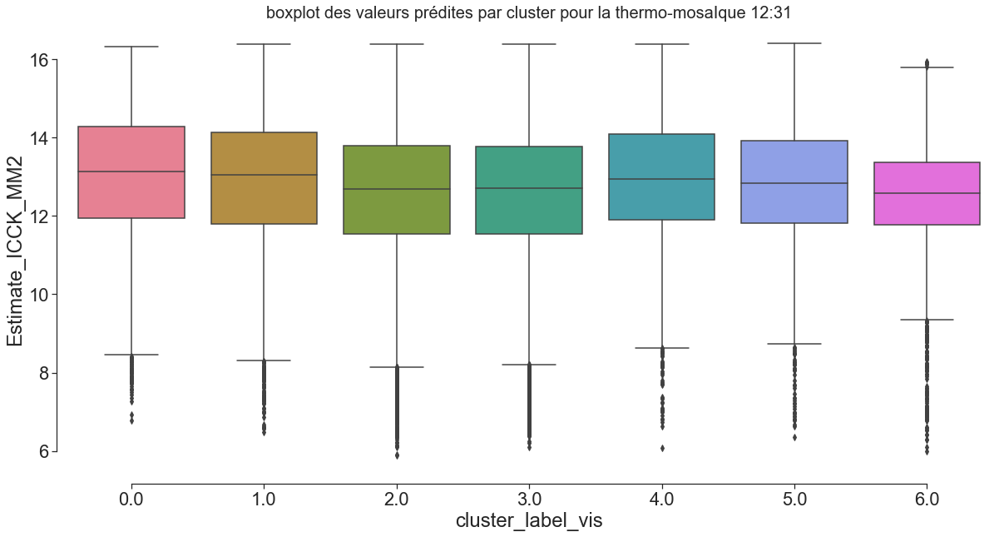

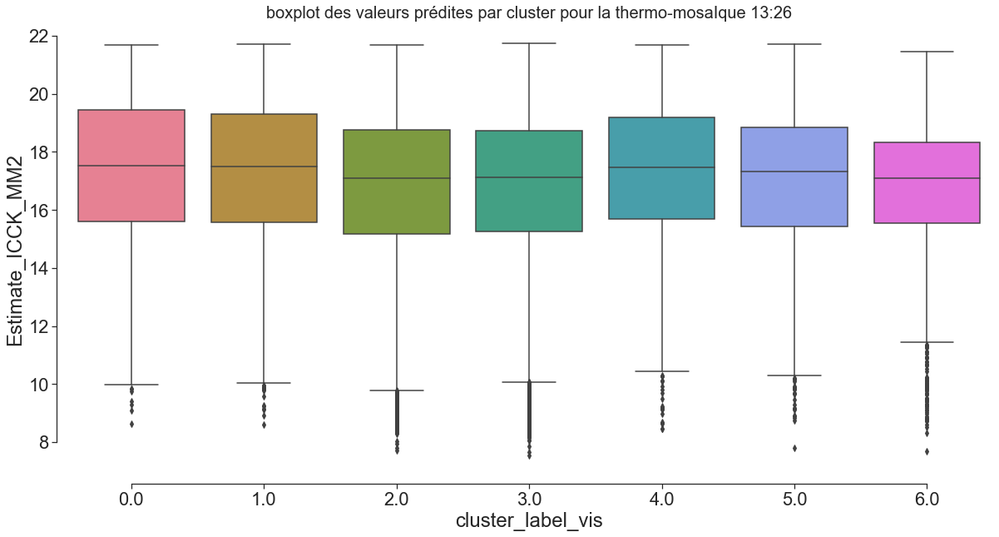

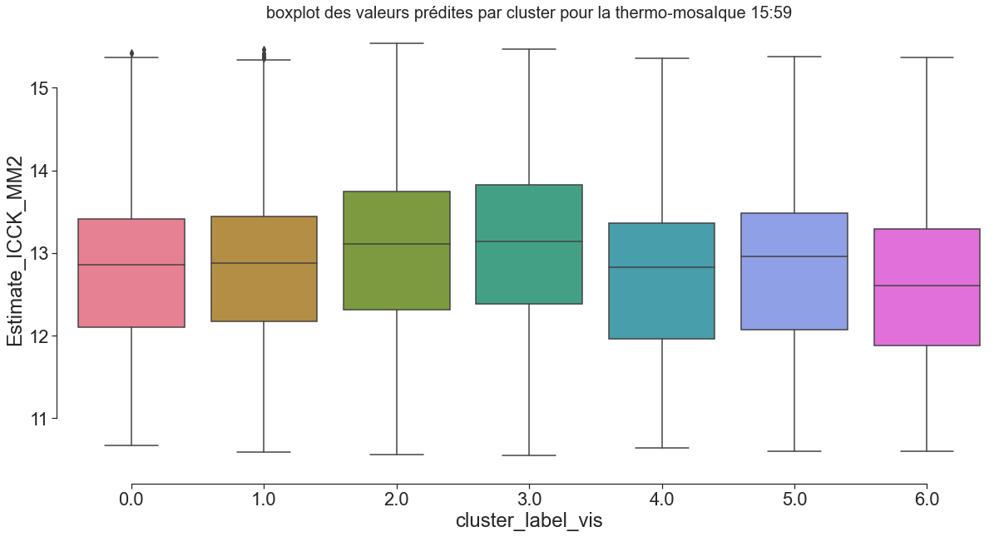

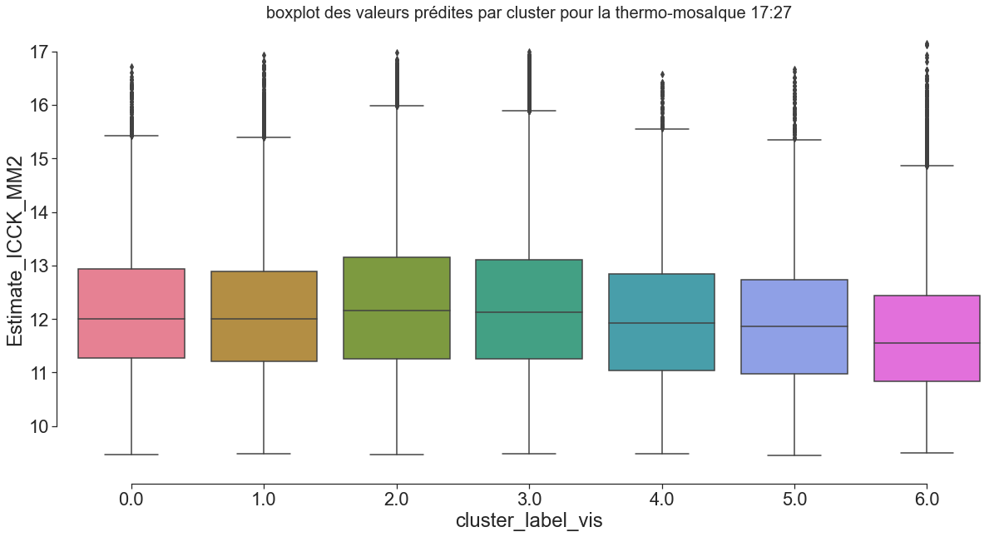

In [683]:
for requested_IR in dict_IR_Df :
    a = requested_IR.find("_")
    b = requested_IR.find("H")
    IR_name =  requested_IR[a+1 : b] + ":" + requested_IR[b+1::]
    TEMP = "T4"
    a = requested_IR.find("_")
    b = requested_IR.find("H")
    IR_name =  requested_IR[a+1 : b] + ":" + requested_IR[b+1::]
    filename = "./varr/Estimate/Estimate_"+requested_IR+"_"+TEMP+".npy"
    dict_IR = np.load(filename,allow_pickle='TRUE').item()
    df_kriging = dict_IR["df_kriging"]
    
    fig,ax=plt.subplots(1,1, figsize = (20,10))
    with sns.color_palette("husl",7) as cmap :
        data = df_kriging
        sns.boxplot(x='cluster_label_vis',y="Estimate_ICCK_MM2",
                   data = data,palette = cmap,ax = ax )
        sns.set_theme(style="ticks",font_scale = 2)
        sns.despine(offset=10, trim=True)
    ax.set_title("boxplot des valeurs prédites par cluster pour la thermo-mosaIque "+IR_name, size = 20)

# T moyennes non calibrée + sondes

In [16]:
list_mean_temp = []
list_IR = []
list_T1 = []
list_T2 = []
list_T3 = []
list_T4 = []
list_temp_IR = []
list_pseudo_temp = []
for requested_IR in dict_IR_Df :
    for TEMP in ["T1","T2","T3","T4"] :
        a = requested_IR.find("_")
        b = requested_IR.find("H")
        IR_name =  requested_IR[a+1 : b] + ":" + requested_IR[b+1::]

        Primary_variogram,Primary,varc_1 = Import_variogram(requested_IR,TEMP,"Primary") 
        ## Original non Densifiée
        Primary_original = Primary_variogram["DataFrame"]
        ## Primary Densifiée
        Primary = Primary_variogram["DataFrame_dense"]
        Secondary_variogram,Secondary,varc_2 = Import_variogram(requested_IR,TEMP,"Secondary") 
        cross_variogram,Primary,varc_3 = Import_variogram(requested_IR,TEMP,"Cross")
        
        if TEMP == "T1" :
            list_T1.append(Primary_original["T1"].mean())
        elif TEMP == "T2" :
            list_T2.append(Primary_original["T2"].mean())
        elif TEMP == "T3" :
            list_T3.append(Primary_original["T3"].mean())
        else :
            list_T4.append(Primary_original["T4"].mean())
    list_temp_IR.append(Secondary["band 1"].mean())
    list_IR.append(IR_name)
    list_pseudo_temp.append(Primary["Pseudo_temp"].mean())

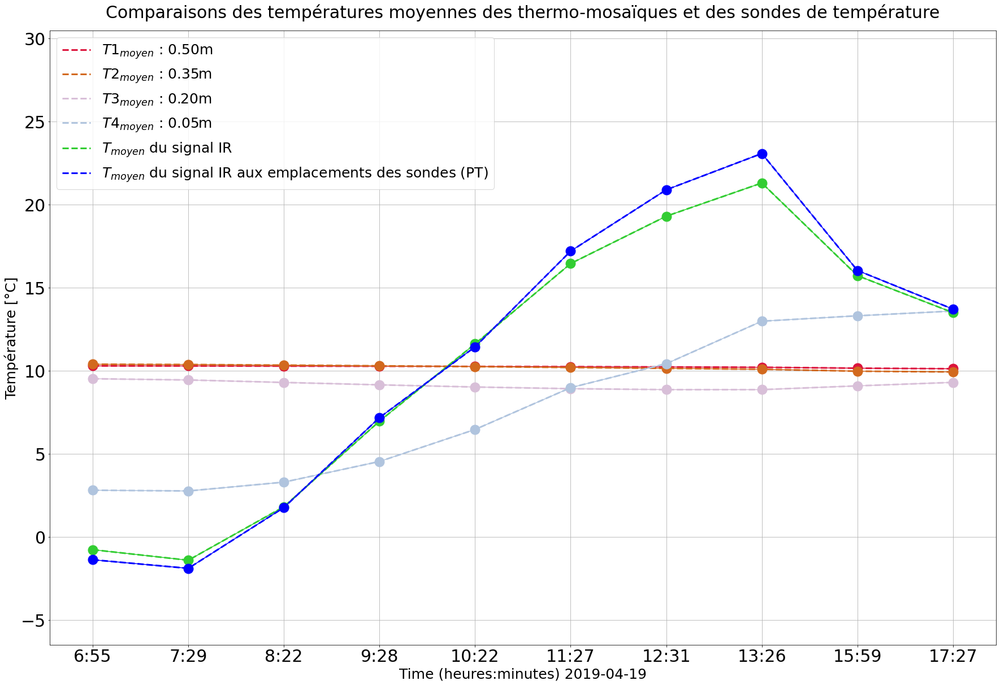

In [19]:
fig,ax = plt.subplots(1,figsize=(30,20))
colours = ["crimson","chocolate","thistle","lightsteelblue","limegreen","blue"]
# T1
ax.plot(list_IR,list_T1,color = colours[0],linewidth = 3,
        linestyle = "--",
        label = "$T1_{moyen}$ : 0.50m" )
ax.plot(list_IR,list_T1,color = colours[0],marker = 'o',
       markersize = 17)

# T2
ax.plot(list_IR,list_T2,color = colours[1], linewidth = 3,
        linestyle = "--",
        label = "$T2_{moyen}$ : 0.35m" )
ax.plot(list_IR,list_T2,color = colours[1],marker = 'o',
       markersize = 17)

# T3
ax.plot(list_IR,list_T3,color = colours[2], linewidth = 3,
        linestyle = "--",
        label = "$T3_{moyen}$ : 0.20m"  )
ax.plot(list_IR,list_T3,color = colours[2],marker = 'o',
       markersize = 17)

# T4
ax.plot(list_IR,list_T4,color = colours[3], linewidth = 3,
        linestyle = "--",
        label = "$T4_{moyen}$ : 0.05m"  )
ax.plot(list_IR,list_T4,color = colours[3],marker = 'o',
       markersize = 17) 

# signal IR
ax.plot(list_IR,list_temp_IR,color = colours[4], linewidth = 3,
        linestyle = "--",
        label = "$T_{moyen}$ du signal IR"  )
ax.plot(list_IR,list_temp_IR,color = colours[4],marker = 'o',
       markersize = 17) 

# Pseudo_temp
ax.plot(list_IR,list_pseudo_temp,color = colours[5], linewidth = 3,
        linestyle = "--",
        label = "$T_{moyen}$ du signal IR aux emplacements des sondes (PT)"  )
ax.plot(list_IR,list_pseudo_temp,color = colours[5],marker = 'o',
       markersize = 17) 

ax.legend(loc="best", prop={"size": 25})
ax.grid()
ax.set_ylim([-6.5,30.5])
ax.set_xlabel('Time (heures:minutes)' + ' 2019-04-19',fontsize=25)
ax.set_ylabel('Température [°C]',fontsize=25)
ax.tick_params(labelsize = 30)
ax.set_title("Comparaisons des températures moyennes des thermo-mosaïques et des sondes de température", size = 30, y = 1.015)
fileout = "C:/Users/Alexandre/Desktop/Cours/Stage/Rapport/Prediction/comparaison_temp_non_calibree.png"
fig.savefig(fileout,bbox_inches = 'tight')

# Température moyenne sur une journée

In [1050]:
# Température au sol pour ke 14 avril 2019
date_1='2019-04-14 06:00:00'
date_2='2019-04-15 05:45:00'
dict_temp_sensor = dict_temp_sensor_function(date_1,date_2)
filename_Sensor_txt = "./traitement_PIREN/sondes_gps_UTM31N_phase1.txt"

In [965]:
dict_temp_sensor.keys() # le dict est rangé oar sonde

dict_keys(['S1', 'S10', 'S2', 'S3-AIR', 'S4', 'S5', 'S6', 'S7', 'S8', 'S9'])

In [1051]:
list_IR = []
list_T1_S1 = []
list_T2_S1 = []
list_T3_S1 = []
list_T4_S1 = []

sensor = "S1"
list_T1_S1.append(dict_temp_sensor[sensor]["T1"])
list_T2_S1.append(dict_temp_sensor[sensor]["T2"])
list_T3_S1.append(dict_temp_sensor[sensor]["T3"])
list_T4_S1.append(dict_temp_sensor[sensor]["T4"])
list_time = [str(time.hour)+':'+str(time.minute) for time in dict_temp_sensor[sensor]["Time"]]
if time 

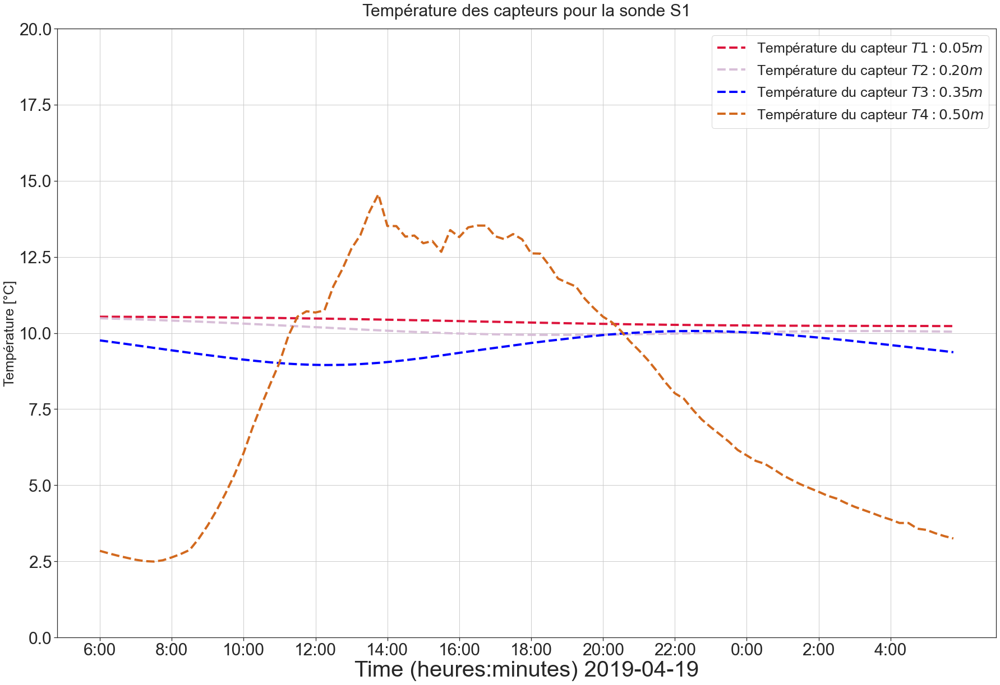

In [1068]:
fig,ax = plt.subplots(1,figsize=(30,20))
colours = ["crimson","chocolate","thistle","lightsteelblue","limegreen","blue"]
# T1
ax.plot(list_time,list_T1_S1[0].to_list(),color = colours[0],linewidth = 4,
    linestyle = "--",
    label = "Température du capteur $T1 : 0.05m$" )

# T2
ax.plot(list_time,list_T2_S1[0].to_list(),color = colours[2], linewidth = 4,
    linestyle = "--",
    label = "Température du capteur $T2 : 0.20m$" )

# T3
ax.plot(list_time,list_T3_S1[0].to_list(),color = colours[5], linewidth = 4,
    linestyle = "--",
    label = "Température du capteur $T3 : 0.35m$"  )

# T4
ax.plot(list_time,list_T4_S1[0].to_list(),color = colours[1], linewidth = 4,
    linestyle = "--",
    label = "Température du capteur $T4 : 0.50m$"  )


ax.set_xticks(list_time[::8])
ax.set_xticklabels([time + "0" for time in list_time[::8] ])
ax.legend(loc="best", prop={"size": 25})
ax.grid()
ax.set_ylim([0,20])

ax.set_xlabel('IR time',fontsize=25)
ax.set_ylabel('Température [°C]',fontsize=25)
ax.tick_params(labelsize = 30)
ax.set_title("Température des capteurs pour la sonde S1", size = 30, y = 1.015)
ax.set_xlabel('Time (heures:minutes)' + ' 2019-04-19' , fontsize = 40)
fileout = "C:/Users/Alexandre/Desktop/Cours/Stage/Rapport/Lien PT_T/temp_S1.png"
fig.savefig(fileout,bbox_inches = 'tight')

# Cross verification

### Création d'un DataFrame df

In [14]:
list_cross_ver = []
data_to_df = []
for sensor in Primary_original["SensorName"].values :
    filename = "./varr/cross_valid/sensor_"+sensor+"_"+requested_IR+"_"+str(TEMP)+".npy"
    dict_kriging_reduce_sensor = np.load(filename,allow_pickle='TRUE').item()
    dict_kriging_reduce_sensor[sensor]["nearby_sensor"] = dict_kriging_reduce_sensor[sensor]["nearby_sensor"].assign(T4 = Primary_original.loc[Primary_original["SensorName"]== sensor]["T4"].reset_index(drop=True)[0])
    dict_kriging_reduce_sensor[sensor]["nearby_sensor"] = dict_kriging_reduce_sensor[sensor]["nearby_sensor"].assign(SensorName = Primary_original.loc[Primary_original["SensorName"]== sensor]["SensorName"].reset_index(drop=True)[0])
    a= dict_kriging_reduce_sensor[sensor]["nearby_sensor"]["Estimate_SCK"].values.astype(str)
    b= dict_kriging_reduce_sensor[sensor]["nearby_sensor"]["Estimate_ICCK_MM2"].values.astype(str)
    c= dict_kriging_reduce_sensor[sensor]["nearby_sensor"]["SensorName"].values.astype(str)
    d= dict_kriging_reduce_sensor[sensor]["nearby_sensor"]["T4"].values.astype(str)
    
    for aa,bb,cc,dd in zip(a,b,c,d) :
        dict1 = dict({"SCK" : aa,"ICCK" : bb,"SensorName" : cc,"T4" : dd})
        data_to_df.append(dict1)



In [15]:
df = pd.DataFrame(data_to_df, columns=['SCK', 'ICCK',"SensorName" ,'T4'])
df = df.astype({'SCK': 'float',"ICCK" : "float", "SensorName" : "str","T4" : "float"})

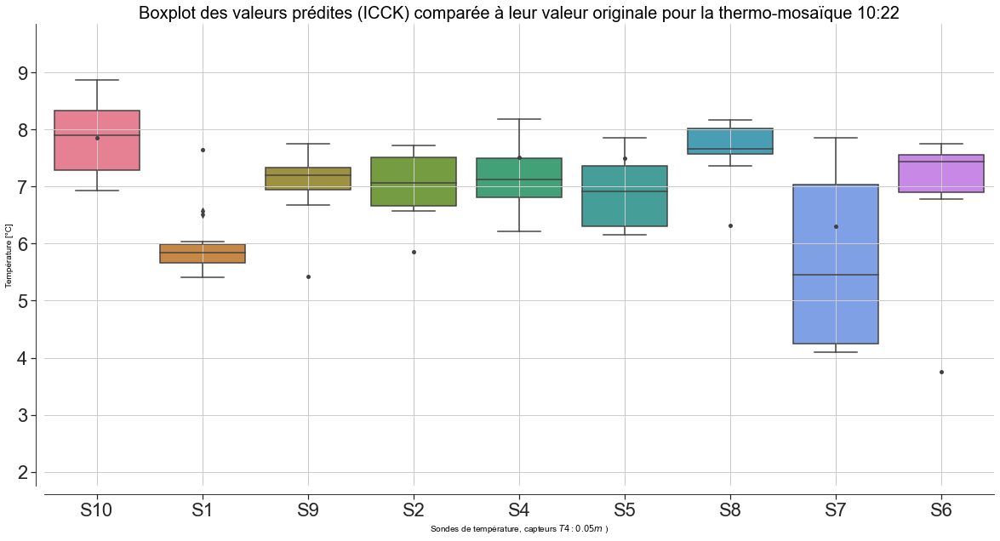

In [16]:
fig,ax=plt.subplots(1,1, figsize = (20,10))
with sns.color_palette("husl",10) as cmap :
    data = df
    sns.boxplot(x='SensorName',y="ICCK",
               data = data,palette = cmap,ax = ax)
    sns.set_theme(style="ticks",font_scale = 2)
    sns.despine(offset=10)

ax.set_title("Boxplot des valeurs prédites (ICCK) comparée à leur valeur originale pour la thermo-mosaïque "+IR_name, size = 20)
ax = sns.swarmplot(x="SensorName", y="T4", data=Primary_original, color=".25")
ax.set_ylim(Primary_original["T4"].min()-2, Primary_original["T4"].max()+2)
ax.set_ylabel("Température [°C]")
ax.set_xlabel("Sondes de température, capteurs $T4 : 0.05m$ )")
ax.grid()

Text(0.5, 0, 'Sondes de température, capteurs $T4 : 0.05m$ ')

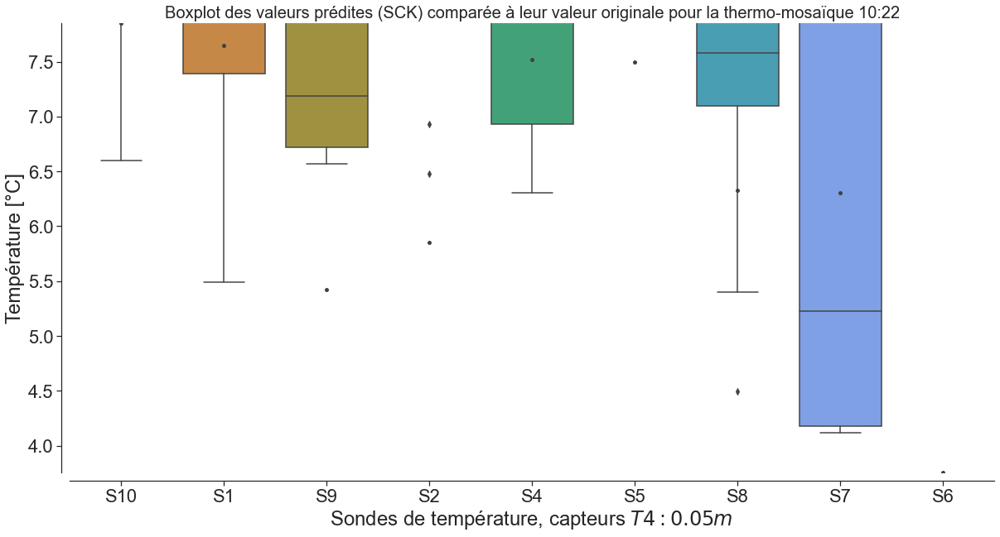

In [17]:
fig,ax=plt.subplots(1,1, figsize = (20,10))
with sns.color_palette("husl",10) as cmap :
    data = df
    sns.boxplot(x='SensorName',y="SCK",
               data = data,palette = cmap,ax = ax)
    sns.set_theme(style="ticks",font_scale = 2)
    sns.despine(offset=10)

ax.set_title("Boxplot des valeurs prédites (SCK) comparée à leur valeur originale pour la thermo-mosaïque "+IR_name, size = 20)
ax = sns.swarmplot(x="SensorName", y="T4", data=Primary_original, color=".25")
ax.set_ylim(Primary_original["T4"].min(), Primary_original["T4"].max())
ax.set_ylabel("Température [°C]")
ax.set_xlabel("Sondes de température, capteurs $T4 : 0.05m$ ")

# T° et T°prédite (Cross Correlation)

In [86]:
# Data au plus proche des sondes
list_cross_ver = []
data_to_df = []
for sensor in Primary_original["SensorName"].values :
    filename = "./varr/cross_valid/sensor_"+sensor+"_"+requested_IR+"_"+str(TEMP)+".npy"
    dict_kriging_reduce_sensor = np.load(filename,allow_pickle='TRUE').item()
    
    sensor_x = Primary_original["x"].loc[Primary_original["SensorName"]==sensor].astype(float).values[0]
    sensor_y = Primary_original["y"].loc[Primary_original["SensorName"]==sensor].astype(float).values[0]
    radius = 0.2 # m
    
    exp =  "(x >= " + str(sensor_x-radius) + ' & ' + "x <= " + str(sensor_x+radius) + " )& ("
    exp += "y >= " + str(sensor_y-radius) + ' & ' + "y <= " + str(sensor_y+radius) + " ) " 

    kriging_dict = dict_kriging_reduce_sensor[sensor]["df_kriging"].query(exp)
    
    # Obtient le point le plus proche de la sonde
    while kriging_dict.shape[0] > 1 :
        exp =  "(x >= " + str(sensor_x-radius) + ' & ' + "x <= " + str(sensor_x+radius) + " )& ("
        exp += "y >= " + str(sensor_y-radius) + ' & ' + "y <= " + str(sensor_y+radius) + " ) " 
        kriging_dict = dict_kriging_reduce_sensor[sensor]["df_kriging"].query(exp)
        radius -= 0.02
        
    kriging_dict = kriging_dict.assign(T4 = Primary_original.loc[Primary_original["SensorName"]== sensor]["T4"].reset_index(drop=True)[0])
    kriging_dict = kriging_dict.assign(SensorName = Primary_original.loc[Primary_original["SensorName"]== sensor]["SensorName"].reset_index(drop=True)[0])
    a= kriging_dict["Estimate_SCK"].values.astype(str)
    b= kriging_dict["Estimate_ICCK_MM2"].values.astype(str)
    c= kriging_dict["SensorName"].values.astype(str)
    d= kriging_dict["T4"].values.astype(str)
    
    for aa,bb,cc,dd in zip(a,b,c,d) :
        dict1 = dict({"SCK" : aa,"ICCK" : bb,"SensorName" : cc,"T4" : dd})
        data_to_df.append(dict1)



In [ ]:
df_close = pd.DataFrame(data_to_df, columns=['SCK', 'ICCK',"SensorName" ,'T4'])
df_close = df_close.astype({'SCK': 'float',"ICCK" : "float", "SensorName" : "str","T4" : "float"})

In [89]:
# Data à 1m 
list_cross_ver = []
data_to_df = []
for sensor in Primary_original["SensorName"].values :
    filename = "./varr/cross_valid/sensor_"+sensor+"_"+requested_IR+"_"+str(TEMP)+".npy"
    dict_kriging_reduce_sensor = np.load(filename,allow_pickle='TRUE').item()
    
    sensor_x = Primary_original["x"].loc[Primary_original["SensorName"]==sensor].astype(float).values[0]
    sensor_y = Primary_original["y"].loc[Primary_original["SensorName"]==sensor].astype(float).values[0]
    radius = 1 # m
    
    exp =  "(x >= " + str(sensor_x-radius) + ' & ' + "x <= " + str(sensor_x+radius) + " )& ("
    exp += "y >= " + str(sensor_y-radius) + ' & ' + "y <= " + str(sensor_y+radius) + " ) " 

    kriging_dict = dict_kriging_reduce_sensor[sensor]["df_kriging"].query(exp)
        
    kriging_dict = kriging_dict.assign(T4 = Primary_original.loc[Primary_original["SensorName"]== sensor]["T4"].reset_index(drop=True)[0])
    kriging_dict = kriging_dict.assign(SensorName = Primary_original.loc[Primary_original["SensorName"]== sensor]["SensorName"].reset_index(drop=True)[0])
    a= kriging_dict["Estimate_SCK"].values.astype(str)
    b= kriging_dict["Estimate_ICCK_MM2"].values.astype(str)
    c= kriging_dict["SensorName"].values.astype(str)
    d= kriging_dict["T4"].values.astype(str)
    
    for aa,bb,cc,dd in zip(a,b,c,d) :
        dict1 = dict({"SCK" : aa,"ICCK" : bb,"SensorName" : cc,"T4" : dd})
        data_to_df.append(dict1)



In [90]:
df_1m = pd.DataFrame(data_to_df, columns=['SCK', 'ICCK',"SensorName" ,'T4'])
df_1m = df_1m.astype({'SCK': 'float',"ICCK" : "float", "SensorName" : "str","T4" : "float"})

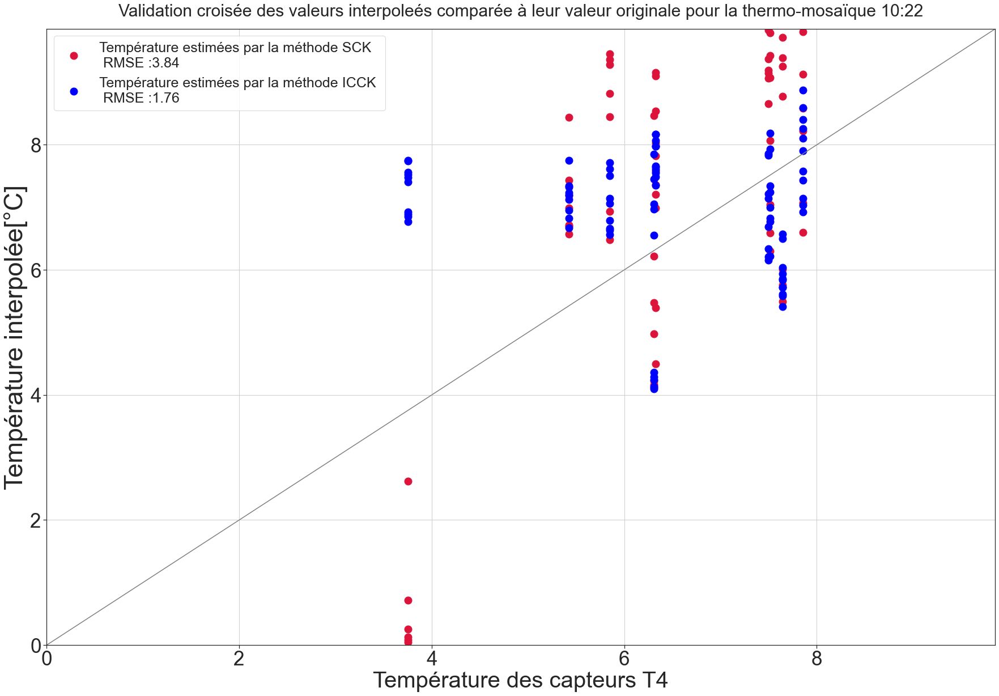

In [33]:
fig,ax = plt.subplots(1,figsize=(30,20))
colours = ["crimson","chocolate","thistle","lightsteelblue","limegreen","blue"]
# SCK
x = df["T4"]
y = df["SCK"]
RMSE_SCK = np.sqrt(mean_squared_error(x,y))

ax.plot(df["T4"],df["SCK"],colours[0], marker = 'o',linestyle= 'none',markersize = 13,
           label = "Température estimées par la méthode SCK \n RMSE :"+"{:.2f}".format(RMSE_SCK) )

# ICCK
x = df["T4"]
y = df["ICCK"]
RMSE_ICCK = np.sqrt(mean_squared_error(x,y))
ax.plot(df["T4"],df["ICCK"],colours[5], marker = 'o',linestyle= 'none',markersize = 13,
           label = "Température estimées par la méthode ICCK \n RMSE :"+"{:.2f}".format(RMSE_ICCK) )

# Droite 1:1
x = np.arange(40)
y = np.arange(40)
ax.plot(x,y,"grey")



ax.legend(loc="best", prop={"size": 25}, fontsize = 20)
ax.grid()
ax.set_ylim([0,df["T4"].max()+2])
ax.set_xlim([0,df["T4"].max()+2])

ax.set_xlabel('IR time',fontsize=30)
ax.set_ylabel('Température interpolée[°C]',fontsize=45)
ax.tick_params(labelsize = 35)
ax.set_title("Validation croisée des valeurs interpoleés comparée à leur valeur originale pour la thermo-mosaïque "+IR_name, size = 30, y = 1.015)
ax.set_xlabel( "Température des capteurs T4", fontsize = 40)
fileout = "C:/Users/Alexandre/Desktop/Cours/Stage/Rapport/Prediction/cross_verification.png"
fig.savefig(fileout,bbox_inches = 'tight')

In [97]:
df_close

,SCK,ICCK,SensorName,T4
0,12.125270,8.403986,S10,7.854
1,5.756526,5.716186,S1,7.646
2,6.717477,7.753266,S9,5.424
3,9.281126,6.791463,S2,5.850
4,9.077465,6.997860,S4,7.517
5,9.191640,7.145522,S5,7.498
6,7.359964,7.642716,S8,6.325
7,4.227674,7.451094,S7,6.306
8,0.132082,6.849197,S6,3.753


,SCK,ICCK,SensorName,T4
0,8.582027,7.574830,S10,7.854
1,6.596420,7.142158,S10,7.854
2,9.125093,7.435575,S10,7.854
3,7.071152,6.921676,S10,7.854
4,8.220779,8.870664,S10,7.854
...,...,...,...,...
82,0.719082,7.474354,S6,3.753
83,-0.821932,7.739877,S6,3.753
84,-0.684069,7.750622,S6,3.753
85,-0.514794,7.403401,S6,3.753


In [103]:
df_close

,SCK,ICCK,SensorName,T4
0,12.125270,8.403986,S10,7.854
1,5.756526,5.716186,S1,7.646
2,6.717477,7.753266,S9,5.424
3,9.281126,6.791463,S2,5.850
4,9.077465,6.997860,S4,7.517
5,9.191640,7.145522,S5,7.498
6,7.359964,7.642716,S8,6.325
7,4.227674,7.451094,S7,6.306
8,0.132082,6.849197,S6,3.753


Text(0.5, 0, 'Température des capteurs T4')

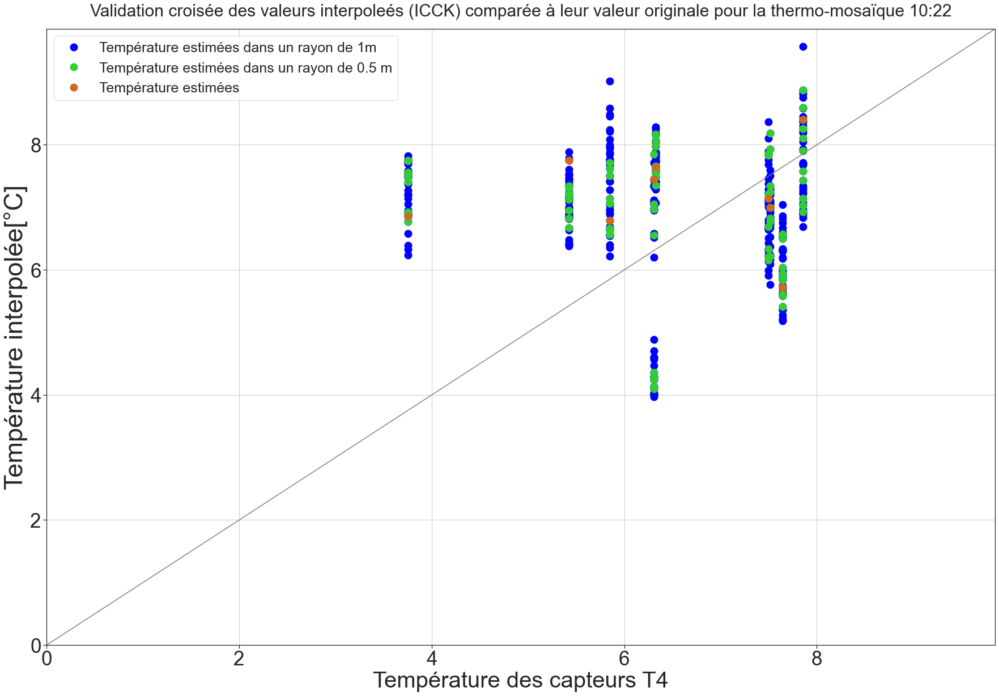

In [109]:
fig,ax = plt.subplots(1,figsize=(30,20))
colours = ["crimson","chocolate","thistle","lightsteelblue","limegreen","blue"]





# 1.0m
x = df_1m["T4"]
y = df_1m["ICCK"]
RMSE_ICCK = np.sqrt(mean_squared_error(x,y))
ax.plot(x,y,colours[5], marker = 'o',linestyle= 'none',markersize = 13,
           label = "Température estimées dans un rayon de 1m" )

# 50cm
x = df["T4"]
y = df["ICCK"]
RMSE_ICCK = np.sqrt(mean_squared_error(x,y))
ax.plot(x,y,colours[4], marker = 'o',linestyle= 'none',markersize = 13,
           label = "Température estimées dans un rayon de 0.5 m" )

# ICCK
x = df_close["T4"]
y = df_close["ICCK"]
RMSE_ICCK = np.sqrt(mean_squared_error(x,y))
ax.plot(x,y,colours[1], marker = 'o',linestyle= 'none',markersize = 13,
           label = "Température estimées" )

# Droite 1:1
x = np.arange(40)
y = np.arange(40)
ax.plot(x,y,"grey")



ax.legend(loc="best", prop={"size": 25}, fontsize = 20)
ax.grid()
ax.set_ylim([0,df["T4"].max()+2])
ax.set_xlim([0,df["T4"].max()+2])

ax.set_xlabel('IR time',fontsize=30)
ax.set_ylabel('Température interpolée[°C]',fontsize=45)
ax.tick_params(labelsize = 35)
ax.set_title("Validation croisée des valeurs interpoleés (ICCK) comparée à leur valeur originale pour la thermo-mosaïque "+IR_name, size = 30, y = 1.015)
ax.set_xlabel( "Température des capteurs T4", fontsize = 40)
#fileout = "C:/Users/Alexandre/Desktop/Cours/Stage/Rapport/Prediction/cross_verification.png"
#fig.savefig(fileout,bbox_inches = 'tight')

In [99]:
df_close

,SCK,ICCK,SensorName,T4
0,12.125270,8.403986,S10,7.854
1,5.756526,5.716186,S1,7.646
2,6.717477,7.753266,S9,5.424
3,9.281126,6.791463,S2,5.850
4,9.077465,6.997860,S4,7.517
5,9.191640,7.145522,S5,7.498
6,7.359964,7.642716,S8,6.325
7,4.227674,7.451094,S7,6.306
8,0.132082,6.849197,S6,3.753


### Color_palette en plus

1
2
3
4
5
6
7
8
9


Text(0.5, 0, 'Température des capteurs T4')

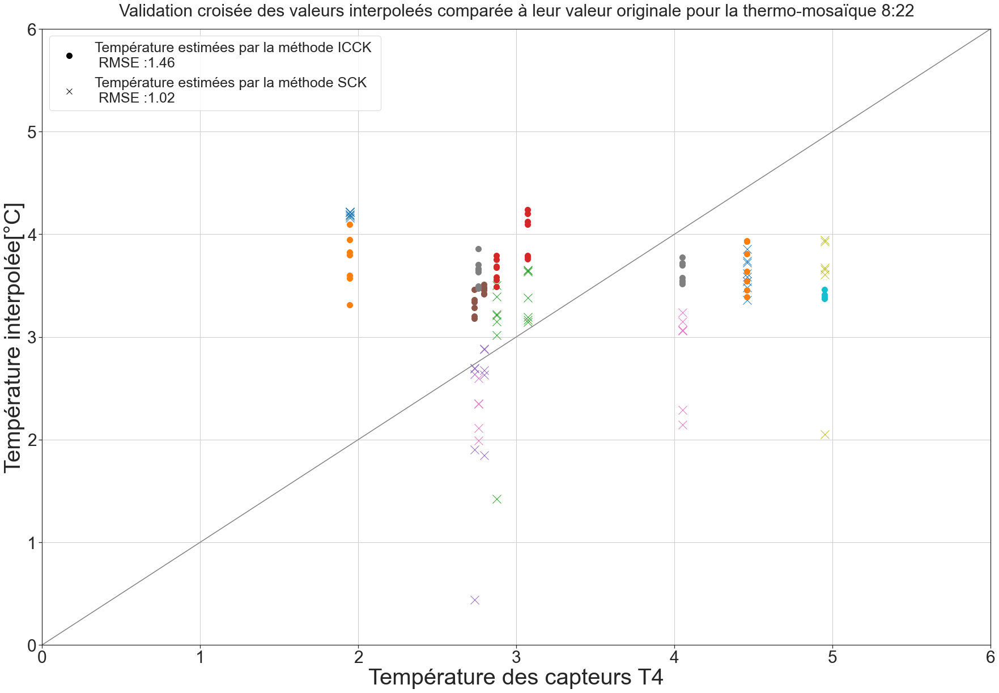

In [78]:
fig,ax = plt.subplots(1,figsize=(30,20))
ii = 0
a = sns.color_palette("husl",10) # colorpalette
for sensor in Primary_original["SensorName"] :
    
    # SCK
    x = df["T4"].loc[df["SensorName"]== sensor].values
    y = df["SCK"].loc[df["SensorName"]== sensor].values
    IR_name = "8:22"
    ax.plot(x,y, marker = 'x',linestyle= 'none',markersize = 15)

    # ICCK
    x = df["T4"].loc[df["SensorName"]== sensor].values
    y = df["ICCK"].loc[df["SensorName"]== sensor].values
    #RMSE_ICCK = np.sqrt(mean_squared_error(x,y))
    ax.plot(x,y, marker = 'o',linestyle= 'none',markersize = 10)
    ii += 1
    
x = np.arange(10)
y = np.arange(10)
ax.plot(x,y,"grey")

RMSE_SCK = np.sqrt(mean_squared_error(df["T4"],df["SCK"]))
RMSE_ICCK = np.sqrt(mean_squared_error(df["T4"],df["ICCK"]))
plt.plot([],[], marker = 'o', color = "black" , linestyle= 'none',markersize = 10, label = "Température estimées par la méthode ICCK \n RMSE :"+"{:.2f}".format(RMSE_SCK))
plt.plot([],[], marker = 'x', color = "black" , linestyle= 'none',markersize = 10, label = "Température estimées par la méthode SCK \n RMSE :"+"{:.2f}".format(RMSE_ICCK))


ax.legend(loc="best", prop={"size": 25})
ax.grid()
ax.set_ylim([0,6])
ax.set_xlim([0,6])

ax.set_xlabel('IR time',fontsize=25)
ax.set_ylabel('Température interpolée[°C]',fontsize=40)
ax.tick_params(labelsize = 30)
ax.set_title("Validation croisée des valeurs interpoleés comparée à leur valeur originale pour la thermo-mosaïque "+IR_name, size = 30, y = 1.015)
ax.set_xlabel( "Température des capteurs T4", fontsize = 40)
#fileout = "C:/Users/Alexandre/Desktop/Cours/Stage/Rapport/Prediction/cross_verification.png"
#fig.savefig(fileout,bbox_inches = 'tight')

# Boxplot de toutes les predictions + cluster

In [80]:
df_kriging = dict_IR["df_kriging"]
df_kriging.keys()

Index(['x', 'y', 'z', 'NS_Estimate_SCK', 'Estimate_SCK', 'cluster_label_vis',
       'val_cluster_hsv', 'NS_Estimate_ICCK_MM2', 'Estimate_ICCK_MM2'],
      dtype='object')

In [81]:
dict_IR_Df.keys()

dict_keys(['IR_6H55', 'IR_7H29', 'IR_8H22', 'IR_9H28', 'IR_10H22', 'IR_11H27', 'IR_12H31', 'IR_13H26', 'IR_15H59', 'IR_17H27'])

In [204]:
data_to_df = []
for requested_IR in dict_IR_Df :
    print(requested_IR)
    a = requested_IR.find("_")
    b = requested_IR.find("H")
    IR_name =  requested_IR[a+1 : b] + ":" + requested_IR[b+1::]
    TEMP = "T4"
    filename = "./varr/Estimate/Estimate_"+requested_IR+"_"+TEMP+".npy"
    dict_IR = np.load(filename,allow_pickle='TRUE').item()
    df_kriging = dict_IR["df_kriging"]
    df_kriging["IR_name"] = IR_name
    
    a= df_kriging["Estimate_SCK"].values
    b= df_kriging["Estimate_ICCK_MM2"].values
    c= df_kriging["val_cluster_hsv"].values
    d= df_kriging["IR_name"].values
    
    for aa,bb,cc,dd in zip(a,b,c,d) :
        dict1 = dict({"SCK" : aa,"ICCK" : bb,"Cluster_hsv" : cc,"IR_name" : dd})
        data_to_df.append(dict1)




IR_6H55
IR_7H29
IR_8H22
IR_9H28
IR_10H22
IR_11H27
IR_12H31
IR_13H26
IR_15H59
IR_17H27


In [206]:
df = pd.DataFrame(data_to_df, columns=['SCK', 'ICCK',"Cluster_hsv" ,'IR_name'])
df = df.astype({'SCK': 'float',"ICCK" : "float", "Cluster_hsv" : "float","IR_name" : "str"})

In [207]:
df.head()

,SCK,ICCK,Cluster_hsv,IR_name
0,0.409594,2.383775,0.0,6:55
1,0.401519,2.383220,0.0,6:55
2,0.460873,2.382353,0.0,6:55
3,0.384332,2.383010,0.0,6:55
4,0.465894,2.392394,3.0,6:55


### Modification de la colormap sns turbo qui manque une couleur

In [149]:
color_map = cm.get_cmap('turbo', 7)
cmap = [] # colormap
for color in color_map.colors :
    cmap.append(color[0:-1])

Text(0.5, 0, 'Time (heures:minutes) 2019-04-19')

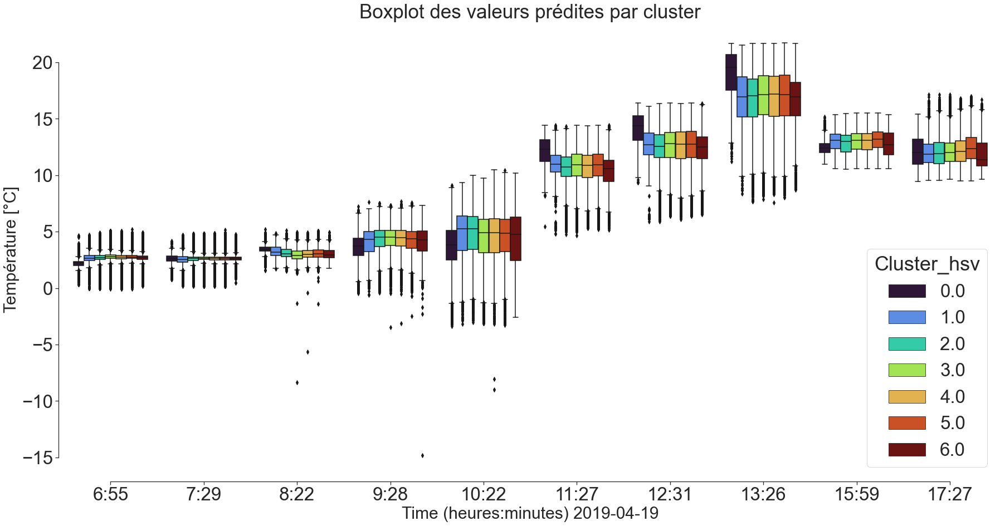

In [150]:
fig,ax=plt.subplots(1,1, figsize = (30,15))

data = df
sns.boxplot(x='IR_name',y="ICCK",
           data = data,hue = "Cluster_hsv",palette = cmap,ax = ax )
sns.set_theme(style="ticks",font_scale = 3)
sns.despine(offset=10, trim=True)
ax.set_title("Boxplot des valeurs prédites par cluster", size = 35)
ax.set_ylabel("Température [°C]", fontsize = 30)
ax.set_xlabel('Time (heures:minutes)' + ' 2019-04-19' , fontsize = 30)

# Température au sol sur une semaine

In [379]:
date_1='2019-04-14 06:00:00'
date_2='2019-04-21 05:45:00'
dict_temp_sensor = dict_temp_sensor_function(date_1,date_2)
filename_Sensor_txt = "./traitement_PIREN/sondes_gps_UTM31N_phase1.txt"

In [381]:
dict_temp_sensor["S1"]

,Num,Time,T1,T2,T3,T4,SensorName
456,457,2019-04-14 06:00:00,10.534,10.484,9.757,2.845,S1
457,458,2019-04-14 06:15:00,10.533,10.475,9.717,2.762,S1
458,459,2019-04-14 06:30:00,10.533,10.467,9.677,2.685,S1
459,460,2019-04-14 06:45:00,10.531,10.458,9.637,2.617,S1
460,461,2019-04-14 07:00:00,10.530,10.449,9.595,2.552,S1
...,...,...,...,...,...,...,...
1126,1127,2019-04-21 04:45:00,11.793,12.702,13.587,9.497,S1
1127,1128,2019-04-21 05:00:00,11.801,12.704,13.547,9.382,S1
1128,1129,2019-04-21 05:15:00,11.807,12.705,13.506,9.265,S1
1129,1130,2019-04-21 05:30:00,11.815,12.705,13.466,9.145,S1


In [965]:
dict_temp_sensor.keys()

dict_keys(['S1', 'S10', 'S2', 'S3-AIR', 'S4', 'S5', 'S6', 'S7', 'S8', 'S9'])

In [403]:
list_IR = []
list_T1_S1 = []
list_T2_S1 = []
list_T3_S1 = []
list_T4_S1 = []

sensor = "S1"
list_T1_S1.append(dict_temp_sensor[sensor]["T1"])
list_T2_S1.append(dict_temp_sensor[sensor]["T2"])
list_T3_S1.append(dict_temp_sensor[sensor]["T3"])
list_T4_S1.append(dict_temp_sensor[sensor]["T4"])
list_time = ["(0"+str(time.month)+"/" + str(time.day)+") - " + str(time.hour)+':'+str(time.minute) for time in dict_temp_sensor[sensor]["Time"]]


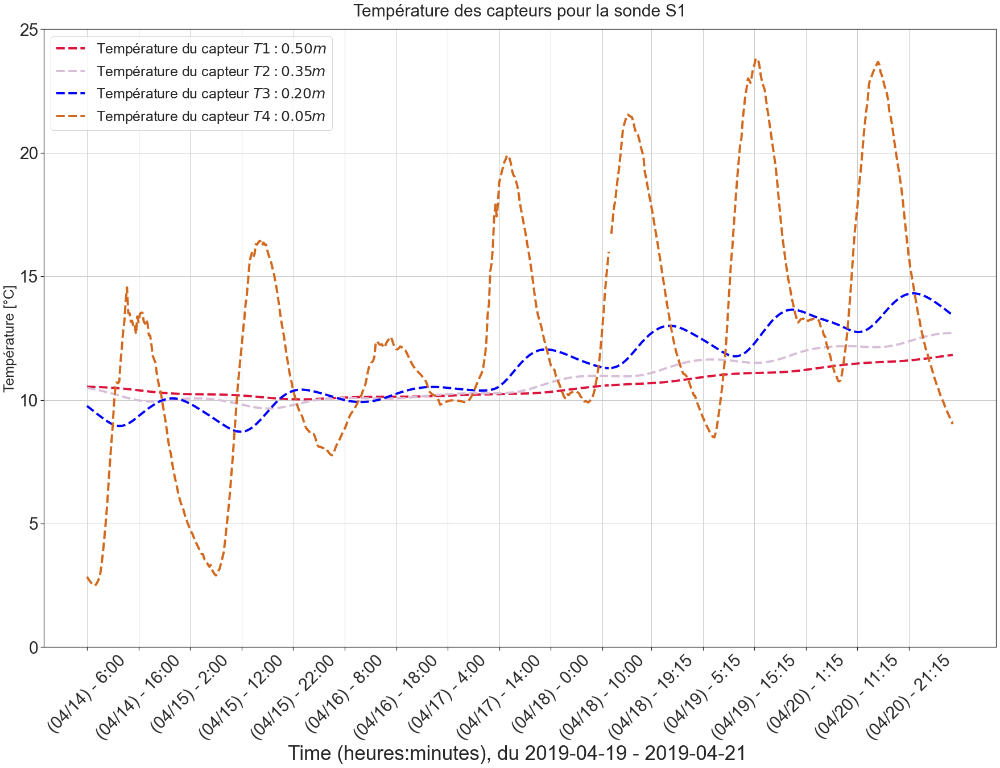

In [439]:
fig,ax = plt.subplots(1,figsize=(30,20))
colours = ["crimson","chocolate","thistle","lightsteelblue","limegreen","blue"]
# T1
ax.plot(list_time,list_T1_S1[0].to_list(),color = colours[0],linewidth = 4,
    linestyle = "--",
    label = "Température du capteur $T1 : 0.50m$" )

# T2
ax.plot(list_time,list_T2_S1[0].to_list(),color = colours[2], linewidth = 4,
    linestyle = "--",
    label = "Température du capteur $T2 : 0.35m$" )

# T3
ax.plot(list_time,list_T3_S1[0].to_list(),color = colours[5], linewidth = 4,
    linestyle = "--",
    label = "Température du capteur $T3 : 0.20m$")

# T4
ax.plot(list_time,list_T4_S1[0].to_list(),color = colours[1], linewidth = 4,
    linestyle = "--",
    label = "Température du capteur $T4 : 0.05m$"  )

ech_tick = 40
ax.set_xticks(list_time[::ech_tick])
tick_label = [time for time in list_time[::ech_tick] ]
for ii,tick in enumerate(tick_label) : 
    if tick[-1] == "0" :
        #print(tick)
        tick_label[ii] = tick_label[ii]+"0"
        #print(tick_label[ii], "\n")
ax.set_xticklabels(tick_label)
plt.xticks(rotation=45)
ax.legend(loc="best", prop={"size": 25})
ax.grid()
ax.set_ylim([0,25])

ax.set_xlabel('IR time',fontsize=25)
ax.set_ylabel('Température [°C]',fontsize=25)
ax.tick_params(labelsize = 30)
ax.set_title("Température des capteurs pour la sonde S1", size = 30, y = 1.015)
ax.set_xlabel('Time (heures:minutes),' + ' du 2019-04-19 - 2019-04-21 ' , fontsize = 35)
fileout = "C:/Users/Alexandre/Desktop/Cours/Stage/Rapport/Lien PT_T/temp_S1_semaine.png"
fig.savefig(fileout,bbox_inches = 'tight')

# Toutes les prédictions

In [485]:
filename_Sensor_txt = "./traitement_PIREN/sondes_gps_UTM31N_phase1.txt"
Sensor_df = reading_gps_file(filename_Sensor_txt)
Sensor_df.loc[Sensor_df["SensorName"] != "S3-AIR"]

,SensorName,x,y
0,S10,523628.71,5366296.81
1,S1,523654.74,5366287.75
2,S9,523692.47,5366276.57
3,S2,523660.22,5366258.91
4,S4,523636.075,5366245.545
5,S5,523641.825,5366220.67
6,S8,523649.33,5366188.02
7,S7,523696.655,5366174.0
8,S6,523694.05,5366209.93


In [502]:
df_kriging.keys()

Index(['x', 'y', 'z', 'NS_Estimate_SCK', 'Estimate_SCK', 'cluster_label_vis',
       'val_cluster_hsv', 'NS_Estimate_ICCK_MM2', 'Estimate_ICCK_MM2'],
      dtype='object')

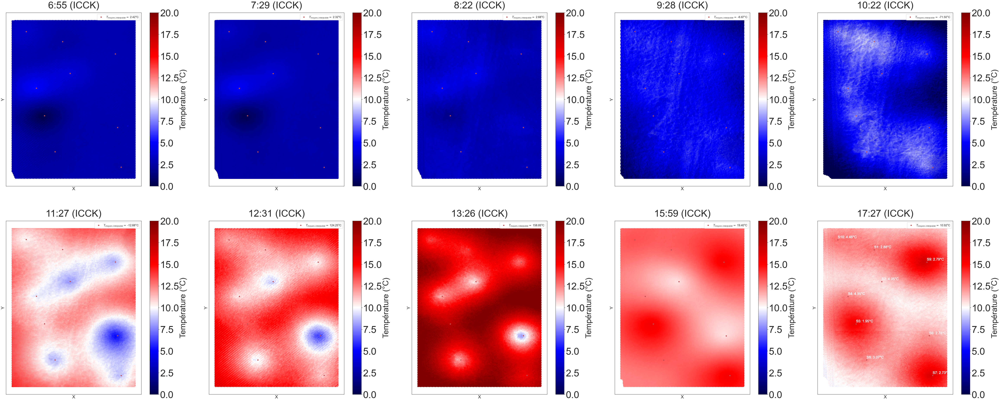

In [503]:
fig,ax = plt.subplots(2,5,figsize = (100,40))
jj = 0
ii = 0
for requested_IR in dict_IR_Df :
    
    a = requested_IR.find("_")
    b = requested_IR.find("H")
    IR_name =  requested_IR[a+1 : b] + ":" + requested_IR[b+1::]
    
    filename = "./varr/Estimate/Estimate_"+requested_IR+"_"+TEMP+".npy"
    dict_IR = np.load(filename,allow_pickle='TRUE').item()

    # On déballe les dicts

    dict_title = dict_IR["title"]
    df_kriging = dict_IR["df_kriging"]
    ktypes_vals_dict = dict_IR["ktypes_vals_dict"]
    dict_primary = dict_IR["dict_primary"]
    dict_cross = dict_IR["dict_cross"]
    dict_secondary = dict_IR["dict_secondary"]
    dict_scalling = dict_IR["dict_scalling"]
    dict_primary_LMC = dict_IR["dict_primary_LMC"]
    dict_cross_LMC = dict_IR["dict_cross_LMC"]
    dict_secondary_LMC = dict_IR["dict_secondary_LMC"]


    X = df_kriging["x"].values
    Y = df_kriging["y"].values
    Z = df_kriging["Estimate_ICCK_MM2"].values

    # On check les matrices crées, prend du temps à zaper si on s'en fout
    ech = 1
    img0 = ax[ii,jj].scatter(X,Y,c = Z, cmap = "seismic",vmin = 0, vmax = 20)
    ax[ii,jj].set_xlabel('X',fontsize=25)
    ax[ii,jj].set_ylabel('Y',fontsize=25)
    cbar = fig.colorbar(img0, ax=ax[ii,jj])
    ax[ii,jj].set_title(IR_name + " (ICCK)",
                 size = 55, pad = 25)
    cbar.set_label(label = "Température (°C)",size = 45)
    cbar.ax.tick_params(labelsize=55) 

    LABEL = "$T_{moyen,interpolée}=$ " + "{:.2f}".format(df_kriging["Estimate_SCK"].mean()) + "°C" 
    Estimate_sensor_df = Sensor_df.loc[Sensor_df["SensorName"] != "S3-AIR"]
    Target_x = np.array(Estimate_sensor_df["x"],dtype = float)
    Target_y = np.array(Estimate_sensor_df["y"],dtype = float)
    Sensor_Name = np.array(Estimate_sensor_df["SensorName"],dtype = str)
    Sensor_value = np.array(Primary_original[TEMP])

    ax[ii,jj].plot(Target_x,Target_y,"ro", label = LABEL)
    for k in range(len(Target_x)) :
        plt.text(Target_x[k],Target_y[k]+1.5,Sensor_Name[k]+": "+"{:.2f}°C".format(Sensor_value[k]),
                 size = 20 ,color = "white")


    ax[ii,jj].legend(fontsize = 16)

    #fileout = "C:/Users/Alexandre/Desktop/Cours/Stage/Rapport/Prediction/SCK/SCK_Temp_"+requested_IR+".png"
    #fig.savefig(fileout,bbox_inches = 'tight')
    ax[ii,jj].set_xticks([])
    ax[ii,jj].set_yticks([])
    #plt.setp(ax[ii,jj][ii,jj].get_xticklabels(), fontsize=30)
    #plt.setp(ax[ii,jj][ii,jj].get_yticklabels(), fontsize=30)
    jj += 1
    if jj == 5 :
        jj = 0
        ii += 1
        


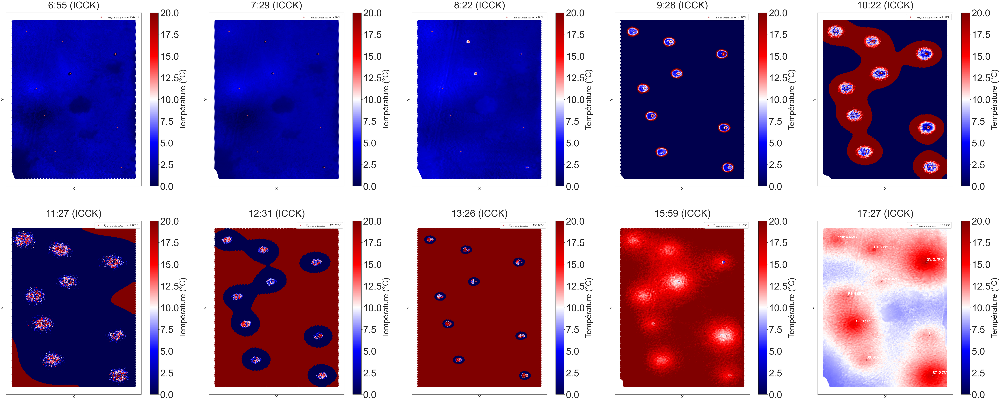

In [208]:
fig,ax = plt.subplots(2,5,figsize = (100,40))
jj = 0
ii = 0
for requested_IR in dict_IR_Df :
    
    a = requested_IR.find("_")
    b = requested_IR.find("H")
    IR_name =  requested_IR[a+1 : b] + ":" + requested_IR[b+1::]
    
    filename = "./varr/Estimate/Estimate_"+requested_IR+"_"+TEMP+".npy"
    dict_IR = np.load(filename,allow_pickle='TRUE').item()

    # On déballe les dicts

    dict_title = dict_IR["title"]
    df_kriging = dict_IR["df_kriging"]
    ktypes_vals_dict = dict_IR["ktypes_vals_dict"]
    dict_primary = dict_IR["dict_primary"]
    dict_cross = dict_IR["dict_cross"]
    dict_secondary = dict_IR["dict_secondary"]
    dict_scalling = dict_IR["dict_scalling"]
    dict_primary_LMC = dict_IR["dict_primary_LMC"]
    dict_cross_LMC = dict_IR["dict_cross_LMC"]
    dict_secondary_LMC = dict_IR["dict_secondary_LMC"]


    X = df_kriging["x"].values
    Y = df_kriging["y"].values
    Z = df_kriging["Estimate_SCK"].values

    # On check les matrices crées, prend du temps à zaper si on s'en fout
    ech = 1
    img0 = ax[ii,jj].scatter(X,Y,c = Z, cmap = "seismic",vmin = 0, vmax = 20)
    ax[ii,jj].set_xlabel('X',fontsize=25)
    ax[ii,jj].set_ylabel('Y',fontsize=25)
    cbar = fig.colorbar(img0, ax=ax[ii,jj])
    ax[ii,jj].set_title(IR_name + " (ICCK)",
                 size = 55, pad = 25)
    cbar.set_label(label = "Température (°C)",size = 45)
    cbar.ax.tick_params(labelsize=55) 

    LABEL = "$T_{moyen,interpolée}=$ " + "{:.2f}".format(df_kriging["Estimate_SCK"].mean()) + "°C" 
    Estimate_sensor_df = Sensor_df.loc[Sensor_df["SensorName"] != "S3-AIR"]
    Target_x = np.array(Estimate_sensor_df["x"],dtype = float)
    Target_y = np.array(Estimate_sensor_df["y"],dtype = float)
    Sensor_Name = np.array(Estimate_sensor_df["SensorName"],dtype = str)
    Sensor_value = np.array(Primary_original[TEMP])

    ax[ii,jj].plot(Target_x,Target_y,"ro", label = LABEL)
    for k in range(len(Target_x)) :
        plt.text(Target_x[k],Target_y[k]+1.5,Sensor_Name[k]+": "+"{:.2f}°C".format(Sensor_value[k]),
                 size = 20 ,color = "white")


    ax[ii,jj].legend(fontsize = 16)

    #fileout = "C:/Users/Alexandre/Desktop/Cours/Stage/Rapport/Prediction/SCK/SCK_Temp_"+requested_IR+".png"
    #fig.savefig(fileout,bbox_inches = 'tight')
    ax[ii,jj].set_xticks([])
    ax[ii,jj].set_yticks([])
    #plt.setp(ax[ii,jj][ii,jj].get_xticklabels(), fontsize=30)
    #plt.setp(ax[ii,jj][ii,jj].get_yticklabels(), fontsize=30)
    jj += 1
    if jj == 5 :
        jj = 0
        ii += 1
        
